<h1><center>Multimodal NLP Project</center></h1>
<h2><center>Visual Question Answering avec VizWiz dataset</center></h2>
<h3><center>Answer Visual Questions from People Who Are Blind</center></h3>

Le jeu de données VizWiz-VQA est un corpus de questions-réponses visuelles conçu pour soutenir le développement de technologies d’assistance destinées aux personnes aveugles. Il a été établit dans un contexte de défi d’intelligence artificielle dont l’objectif était de concevoir des algorithmes capables de répondre à des questions visuelles formulées par des personnes aveugles.

Les données proviennent d’un contexte réel et naturel d’usage : des personnes aveugles ont capturé des images de leur environnement quotidien, puis ont enregistré oralement des questions portant sur ces images. Chaque question visuelle est associée à dix réponses fournies par des annotateurs humains, reflétant la variabilité et l’ambiguïté inhérentes aux scènes du monde réel.

Le défi VizWiz reposait sur deux tâches principales :
1. La prédiction de la réponse à une question visuelle donnée (Visual Question Answering, VQA).
2. La détection des questions sans réponse, c’est-à-dire l’identification des cas où l’image ne permet pas de répondre de manière fiable à la question posée.

Dans notre étude, on se focalise sur le premier objectif : **la prédiction de la réponse à une question visuelle donnée**. Le dataset sera donc filtré pour ne conserver que les instances où une réponse est effectivement fournie. 

Le modèle utilisé est **CLIP**, Contrastive Language-Image Pre-Training.

# IMPORT

In [30]:
from loguru import logger
import os, random, json
import numpy as np
import matplotlib.pyplot as plt

# 1. DATASET

## Principe

La tâche de **Visual Question Answering (VQA)** est formulée ici comme un **problème d’apprentissage contrastif** à l’aide de **CLIP**. Le modèle doit sélectionner la bonne réponse parmi un ensemble de réponses candidates.

**Description du dataset VizWiz**

Chaque échantillon contient :
- une **image**
- une **question**
- **10 réponses humaines** (10 annotateurs différents)

**Définition du label**

- On définit le **label** comme la **réponse majoritaire** parmi les 10 annotations.
- En cas d’égalité, une réponse est **choisie aléatoirement** parmi les ex æquo.

**Réponses candidates**

Pour chaque échantillon, on fixe **20 réponses candidates** :
- **1 réponse positive** : le label
- **19 réponses négatives** : tirées aléatoirement parmi toutes les réponses du dataset, hors label

**Objectif**

Le modèle est entraîné par **apprentissage contrastif** :
- maximiser la similarité image–question–réponse correcte,
- minimiser la similarité avec les réponses incorrectes.

**Évaluation**

À l’inférence, le modèle choisit la réponse ayant le **score de similarité le plus élevé** parmi les 20 candidates.


## VOCABULAIRE

In [2]:
# on a 4 types de questions : other, yes/no, unanswerable, et number
# on enregistre toute les réponses possibles train/val pour chaque type de question

import json
from collections import defaultdict

all_answers_by_type = defaultdict(set)

for split in ['train', 'val']:

    with open(f"./data/annotations/{split}.json") as f:
        data = json.load(f)

    for element in data:
        answer_type = element['answer_type']
        answers = [a['answer'] for a in element['answers']]
        all_answers_by_type[answer_type].update(answers)

keys = all_answers_by_type.keys()
for ans_type in keys:
    print(f'{ans_type:.>20}: ({len(all_answers_by_type[ans_type])}) \t eg. {list(all_answers_by_type[ans_type])[:5]}')

...............other: (42879) 	 eg. ['celery salt', '', 'shiner rye lager ryes shine brewers craft beer', 'key chain game', 'all mighty pacs laundry detergent']
..............yes/no: (974) 	 eg. ['weekend', 'no soda', 'grey box', 'collect points', 'bake microwave']
........unanswerable: (7311) 	 eg. ['', 'blurry pic not dark', 'fdasfga', 'smart phone', 'alibi luan']
..............number: (629) 	 eg. ['no display', '360 degree c', '94', '500 g table salt', 'warm warm 24 minutes colors']


## CLASS DATASET

In [ ]:
from PIL import Image
import torch
from torch.utils.data import Dataset
from transformers import CLIPProcessor

class VizWizVQADataset(Dataset):
    
    def __init__(self, root_folder, split, answers_dict, mode, nb_candidates, max_length, 
                 processor: CLIPProcessor, nb_samples: int, reform_quest: bool=False):
        """
        root_folder : dossier racine du dataset
        split : 'train' ou 'val'
        answers_dict : dictionnaire type_reponse -> liste de réponses possibles
        mode : 'full', 'question only', 'image only'
        nb_candidates : nombre de candidats à considérer
        processor : CLIPProcessor pour images + texte
        nb_samples : nombre d'exemples à charger (-1 pour utiliser tout le dataset)
        reform_quest : booléen qui indique si on doit utilisée les questions reformulées (cf. partie améliorée)
        """
        super().__init__()
        self.root_folder = root_folder
        self.split = split
        self.processor = processor
        self.answers_dict = answers_dict
        self.mode = mode
        self.nb_candidates = nb_candidates
        self.max_length = max_length
        self.nb_samples = nb_samples
        self.reform_quest = reform_quest
        self.samples = []

        # Création d'un vocabulaire pour labels et candidats
        all_answers = set()
        for lst in answers_dict.values():
            all_answers.update(lst)
        self.vocab = {ans: idx for idx, ans in enumerate(all_answers)}

        # Chargement des annotations
        if not self.reform_quest:
            ann_path = os.path.join(root_folder, 'annotations', f'{split}.json')
            with open(ann_path) as f:
                ann = json.load(f)
        else: # Annotations reformulées (cf. 4. Améliorer la formulation des questions)
            ann_path = os.path.join(root_folder, 'annotations', f'reform_{split}.json')
            with open(ann_path) as f:
                ann = json.load(f)

        counter = 0
        for el in ann:
            
            answer_type = el['answer_type']
            if answer_type == 'unanswerable':
                continue

            if (self.nb_samples > 0) and (counter >= self.nb_samples):
                break

            image_name = el['image']
            image_path = os.path.join(root_folder, split, image_name)
            if not os.path.isfile(image_path):
                raise FileNotFoundError(f"Le fichier {image_path} n'existe pas !")
            
            if not self.reform_quest:
                question = el['question']
            else:
                question = el['reform_question']
            answers = [a['answer'] for a in el['answers']]

            # Label : réponse la plus fréquente
            ans_dict = {ans: answers.count(ans) for ans in set(answers)}
            label_str = max(
                (k for k in ans_dict if k != 'unanswerable'),
                key=lambda k: (ans_dict[k], len(k))
            )

            # Candidats
            candidates_str = random.sample(list(answers_dict[answer_type]), self.nb_candidates - 1)
            candidates_str.append(label_str)
            random.shuffle(candidates_str)

            self.samples.append({
                "image_path": image_path,
                "question": question,
                "label": label_str,
                "candidates": candidates_str
            })

            counter += 1

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        sample = self.samples[idx]

        if self.mode == 'vqa':

            # Charger l'image
            image = Image.open(sample['image_path']).convert("RGB")

            # Générer les textes pour CLIP : question + candidat
            texts = [f'{sample['question']} {c}' for c in sample['candidates']]

            # Préparer l'entrée CLIP
            inputs = self.processor(text=texts, images=image, return_tensors="pt", padding="max_length",
                                    max_length=self.max_length, truncation=True)
            
        elif self.mode == 'question only':

            # Créer une image en nuance de gris
            width, height = 224, 224
            image = Image.new("RGB", (width, height), color=(128,128,128))

            # Générer les textes pour CLIP : question + candidat
            texts = [f'{sample['question']} {c}' for c in sample['candidates']]

            # Préparer l'entrée CLIP
            inputs = self.processor(text=texts, images=image, return_tensors="pt", padding="max_length",
                                    max_length=self.max_length, truncation=True)
            
        elif self.mode == 'image only':

            # Charger l'image
            image = Image.open(sample['image_path']).convert("RGB")

            # Générer les textes pour CLIP : question + candidat
            texts = [f'{c}' for c in sample['candidates']]

            # Préparer l'entrée CLIP
            inputs = self.processor(text=texts, images=image, return_tensors="pt", padding="max_length",
                                    max_length=self.max_length, truncation=True)
            
        else:

            raise ValueError(f"mode={self.mode} not in ('vqa', 'question only', 'image only')")

        # Conversion du label en indice
        label_idx = sample['candidates'].index(sample['label'])
        candidates_idx = torch.arange(len(sample['candidates']))    # juste 0..N-1

        return {
            "pixel_values": inputs['pixel_values'].squeeze(0),
            "input_ids": inputs['input_ids'],                       # texte tokeniser pour cq candidat [num_candidates, seq_len=77]
            "attention_mask": inputs['attention_mask'],             # masque de input_ids : 1 -> token, 0 -> padding
            "label": torch.tensor(label_idx, dtype=torch.long),     # idx du label dans raw_candidates
            "candidates": candidates_idx,                           # listes des idx 0...N-1
            "raw_candidates": sample['candidates'],                 # texte des candidats (pour vizualisation)
            "question_text": sample['question'],                    # texte de la question (pour visualisation)
            "image_path" : sample['image_path']
        }


**Remarques :**

Dans la mesure où l'on utilise le `CLIPProcessor` (wrapper regroupant `CLIPTokenizer` et `CLIPImageProcessor`) pour gérer l'embedding du texte et des images, il n'y a pas lieu de prétraiter le texte manuellement. 

Cette tâche est directement prise en charge par le `CLIPTokenizer` intégré, auquel le `CLIPProcessor` fait appel pour normaliser les données et les rendre conformes aux attentes du modèle.

La cellule ci-dessous illustre un exemple de prétraitement qui aurait pu être réalisé si le nettoyage et la numérisation avaient été effectués manuellement.

In [4]:
import re
import unicodedata
import nltk
from nltk.corpus import stopwords

nltk.download("stopwords")
stop_words = set(stopwords.words("french"))

# PREPROCESSING
def preprocess(text):

    # 1. Lowercase
    text = text.lower()

    # 2. Normalize unicode and remove accents by keeping only ASCII
    text = unicodedata.normalize('NFKD', text).encode('ASCII', 'ignore')\
            .decode('utf-8')

    # 3. Keep only alphanumeric (a-z, 0-9) and spaces
    text = re.sub(r"[^a-z0-9 ]", " ", text)

    # 4. Collapse multiple spaces
    text = re.sub(r"\s+", " ", text).strip()

    # 5. Tokenization
    tokens = text.split()

    # 6. Stopword removal
    tokens = [t for t in tokens if t not in stop_words]

    # 7. Return cleaned text
    return " ".join(tokens)


[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/fatoumatawadiou/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## DATASET SHAPE

In [ ]:
from torch.utils.data import DataLoader
from transformers import CLIPProcessor, CLIPModel

model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# PARAMETERS
nb_candidates = 20
bs = 8
root = './data/'
mode = 'vqa'
max_length = 77
nb_candidates = 20
train_samples = 40
val_samples   = 10

# DATA
dataset_train = VizWizVQADataset(root_folder=root,
    split='train',
    answers_dict=all_answers_by_type,
    mode=mode,
    nb_candidates=nb_candidates,
    max_length=max_length,
    processor=processor,
    nb_samples=train_samples
    )
dataset_val = VizWizVQADataset(
    root_folder=root,
    split='val',
    answers_dict=all_answers_by_type,
    mode=mode,
    nb_candidates=nb_candidates,
    max_length=max_length,
    processor=processor,
    nb_samples=val_samples
    )
train_loader = DataLoader(dataset_train, batch_size=bs, shuffle=True, num_workers=0)
val_loader = DataLoader(dataset_val, batch_size=bs, shuffle=False, num_workers=0)

In [6]:
print(f'dataset_train: {len(dataset_train)}')
print(f'dataset_val: {len(dataset_val)}')

print(f'train_loader: {len(train_loader)}')
print(f'val_loader: {len(val_loader)}')


dataset_train: 40
dataset_val: 10
train_loader: 5
val_loader: 2


In [7]:
elem = next(iter(train_loader))

print(f"pixel_values: {elem['pixel_values'].shape}")
print(f"input_ids: {elem['input_ids'].shape}")
print(f"attention_mask: {elem['attention_mask'].shape}")
print(f"label: {elem['label'].shape}")
print(f"candidates: {elem['candidates'].shape}")
print(f"raw_candidates: {elem['raw_candidates']}")

pixel_values: torch.Size([8, 3, 224, 224])
input_ids: torch.Size([8, 20, 77])
attention_mask: torch.Size([8, 20, 77])
label: torch.Size([8])
candidates: torch.Size([8, 20])
raw_candidates: [('us bases around iran', 'blow up swim ring', 'ipad bootcamp workshop packet', 'bench metal framework window', 'not date should be on flat flap on top carton', 'lotion', 'beef merlot', 'afd'), ('canadian money', 'this mouse picture', '32 inch', 'concrete porch floor 2 lantern lights on ground', '150 degrees fahrenheit turn right for higher temperature', 'ebook reader', 'not clear', 'jack links'), ('article about beckham oriented sideways', 'back up', 'i have no idea im sorry', 'aspen', 'comb', 'checking file system on c: to skip press any key within 1 second', 'nonfat', 'regth'), ('glass jar pasta sauce', 'twister game', '18 half', 'yes you can', 'saudi currency', 'eiffel tower model', 'no', 'can lemon lime soda'), ('panthers', 'mulberries', 'green card', 'house cleaner', 'candies men', 'dark orange

In [8]:
# candidates sert de mapping : permet de rettrouver plus facilement le texte 
# qui correspond au texte du candidat (raw_candidates) dans le batch étant données un label

print(f"label: {elem['label']}")
print(f"candidates: {elem['candidates']}")
print(f"raw_candidates: {elem['raw_candidates']}")

label: tensor([ 7, 10, 10, 17,  5,  0,  3,  1])
candidates: tensor([[ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19],
        [ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19],
        [ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19],
        [ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19],
        [ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19],
        [ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19],
        [ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19],
        [ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19]])
raw_candidates: [('us bases around iran', 'blow up swim ring', 'ipad bootcamp workshop packet', 'bench metal framework window', 'not date should be

# MAX TOKEN LENGTH ?

**Estimer la valeur maximale de `max_length` (≤ 77)**

Le choix de `max_length` est un hyperparamètre clé lors de l’utilisation de CLIP, car il impacte directement le coût computationnel, la mémoire utilisée et, potentiellement, les performances du modèle.
Bien que CLIP ait été entraîné avec une longueur maximale de **77 tokens**, il n’est pas garanti que cette valeur soit nécessaire pour notre tâche et notre dataset.

Dans cette section, nous effectuons des statistiques descriptives, et dans la section suivante, nous évaluons les performances **sans fine-tuning**.


In [264]:
# DATA

dataset_train = VizWizVQADataset(
    root_folder=root,
    split='train',
    answers_dict=all_answers_by_type,
    mode=mode,
    nb_candidates=nb_candidates,
    max_length=77,
    processor=processor,
    nb_samples=-1          # load full dataset
    )

dataset_val = VizWizVQADataset(
    root_folder=root,
    split='val',
    answers_dict=all_answers_by_type,
    mode=mode,
    nb_candidates=nb_candidates,
    max_length=77,
    processor=processor,
    nb_samples=-1          # load full dataset
    )

train_loader = DataLoader(dataset_train, batch_size=bs, shuffle=True, num_workers=0)
val_loader = DataLoader(dataset_val, batch_size=bs, shuffle=False, num_workers=0)

In [265]:
print(f'dataset_train: {len(dataset_train)}')
print(f'dataset_val: {len(dataset_val)}')

print(f'train_loader: {len(train_loader)}')
print(f'val_loader: {len(val_loader)}')

dataset_train: 14991
dataset_val: 2934
train_loader: 1874
val_loader: 367


In [266]:
# Stats sur le nombre max de token dans le dataset

from transformers import CLIPTokenizer
import numpy as np

tokenizer = CLIPTokenizer.from_pretrained('openai/clip-vit-base-patch32')

lengths = []
display = True

for dataset in [dataset_train, dataset_val]:
    for data in dataset.samples:
        question, candidates = data['question'], data['candidates']
        texts = [f'{question} {candidate}' for candidate in candidates]
        # tokenizer() -> dict: {'input_ids': ..., 'attention_mask': ...}
        tokenize_texts = [tokenizer(text, truncation=False)['input_ids'] for text in texts]
        if display: # Display first example to get an idea
            print('-----Example:')
            print(len(candidates))
            print(f'texts[0] = {texts[0]}')
            print(f"tokenize_texts[0] = {tokenize_texts[0]}")
            print(f"len(tokenize_texts[0]) = {len(tokenize_texts[0])}")
            print('----------\n')
            display = False
        tokenise_lengths = [len(tokenize_text) for tokenize_text in tokenize_texts] 
        lengths.extend(tokenise_lengths)

lengths = np.array(lengths)
print('\n-----Stats about len(tokenize_text):')
print(f"size   : {len(lengths):>6}")
print(f"mean   : {np.mean(lengths):>6.1f}")
print(f"median : {np.median(lengths):>6.1f}")
print(f"p95    : {np.percentile(lengths, 95):>6.1f}")
print(f"p99    : {np.percentile(lengths, 99):>6.1f}")
print(f"max    : {lengths.max():>6}")
print('----------')

-----Example:
20
texts[0] = What's the name of this product? purple teal
tokenize_texts[0] = [49406, 768, 568, 518, 1981, 539, 589, 4306, 286, 5496, 22821, 49407]
len(tokenize_texts[0]) = 12
----------



Token indices sequence length is longer than the specified maximum sequence length for this model (78 > 77). Running this sequence through the model will result in indexing errors



-----Stats about len(tokenize_text):
size   : 358500
mean   :   13.3
median :   12.0
p95    :   25.0
p99    :   39.0
max    :     84
----------


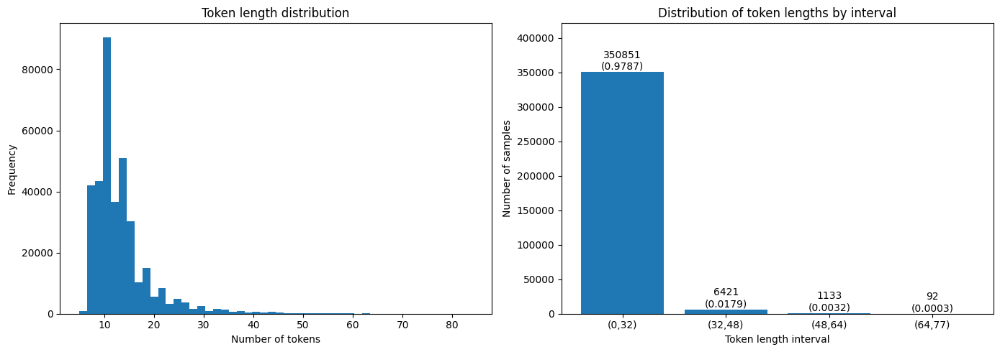

In [267]:
import matplotlib.pyplot as plt
import numpy as np

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Graph 1: Histogram
axes[0].hist(lengths, bins=50)
axes[0].set_xlabel("Number of tokens")
axes[0].set_ylabel("Frequency")
axes[0].set_title("Token length distribution")

# Graph 2: Bar chart by intervals
bins = [(0, 32), (32, 48), (48, 64), (64, 77)]
labels = ["(0,32)", "(32,48)", "(48,64)", "(64,77)"]
counts = [np.sum((lengths > low) & (lengths <= high)) for low, high in bins]

bars = axes[1].bar(labels, counts)
axes[1].set_ylim(0, 1.2 * max(counts))
axes[1].set_xlabel("Token length interval")
axes[1].set_ylabel("Number of samples")
axes[1].set_title("Distribution of token lengths by interval")

for bar in bars:
    height = bar.get_height()
    axes[1].text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f"{height}\n({height / sum(counts):.4f})",
        ha="center",
        va="bottom"
    )

plt.tight_layout()
plt.show()


CLIP a été entraîné avec `max_length = 77`.
En pratique, on choisit souvent `max_length` au **95ᵉ percentile** des longueurs de séquence.

En tokenisant les chaînes **question + " " + answer** avec `CLIPTokenizer` pour l’ensemble des candidats du dataset, on observe une moyenne de 13 token par chaînes candidates, une **longueur maximale de 80 tokens**, et **95ᵉ percentile à 25 tokens**.

Ainsi, **`max_length = 32` est a priori suffisant** : les tokens excédentaires sont simplement remplacés par du *padding*.

Nous allons donc **évaluer cet impact** en comparant les performances sur **VizWiz VQA sans fine-tuning**, en utilisant directement **CLIP**, avec différentes valeurs de `max_length` : **32, 48, 64 et 77**.


# 2. BASELINE

## UTILS FUNCTION

In [23]:
import torch
from torch.nn.functional import cosine_similarity
from loguru import logger

def eval_loop(model, val_loader, device, temperature, log=True):

    model = model.to(device)
    model.eval()  # mode évaluation

    total = 0
    correct = 0
    n = len(val_loader)

    with torch.no_grad():

        for i, batch in enumerate(val_loader):

            # Déplacer les tenseurs sur le bon device
            pixel_values = batch["pixel_values"].to(device)         # [B, 3, 224, 224]
            input_ids = batch["input_ids"].to(device)               # [B, num_candidates, seq_len]
            attention_mask = batch["attention_mask"].to(device)     # [B, num_candidates, seq_len]
            labels = batch["label"].to(device)                      # [B]

            batch_size, num_candidates, seq_len = input_ids.shape

            # Aplatir les candidats pour passer au modèle
            flat_input_ids = input_ids.view(-1, seq_len)            # [B*num_candidates, seq_len]
            flat_attention_mask = attention_mask.view(-1, seq_len)  # [B*num_candidates, seq_len]

            # Embeddings texte et image
            text_embeds = model.get_text_features(flat_input_ids, attention_mask=flat_attention_mask)
            text_embeds = text_embeds.view(batch_size, num_candidates, -1)  # [B, num_candidates, hidden_size]

            image_embeds = model.get_image_features(pixel_values)  # [B, hidden_size]
            image_embeds = image_embeds.unsqueeze(1)               # [B, 1, hidden_size]

            # Similarité cosinus : [B, num_candidates]
            similarities = cosine_similarity(image_embeds, text_embeds, dim=-1)# [B, num_candidates]
            if temperature != None:
                similarities = similarities / temperature
            else: # CLIP on basic config
                scale = model.logit_scale.exp()
                similarities = similarities * scale

            # Prédiction : indice du candidat le plus similaire
            preds = similarities.argmax(dim=1)

            # Calcul précision
            correct += (preds == labels).sum().item()
            total += batch_size

            if log is not None and (i % 3)==0 or (i==(n-1)):
                logger.info(f'Batch {i}/{n-1} \t running_accuracy = {correct/total:.4f}')

    accuracy = correct / total

    return accuracy


## VISUALIZATION FUNCTION

In [56]:
def plot_vqa_sample(idx, batch, sorted_indices, distributed_sim, num_top=20):    

    # Extraction des données
    img = Image.open(batch['image_path'][idx])
    question = batch['question_text'][idx]
    candidates = np.array([c[idx] for c in batch['raw_candidates']])
    label_idx = batch['label'][idx].item()
    gt_text = candidates[label_idx]

    # Tri des prédictions
    idx_triés = sorted_indices[idx]
    top_candidates = candidates[idx_triés]
    top_probs = distributed_sim[idx][idx_triés]

    # Configuration de la figure
    fig = plt.figure(figsize=(18, 6))
    gs = fig.add_gridspec(1, 3, width_ratios=[1.2, 1, 1])
    
    # 1. Affichage Image
    ax_img = fig.add_subplot(gs[0])
    ax_img.imshow(img)
    #ax_img.set_title(f"Question: {question}", fontsize=10, pad=10, wrap=True)
    ax_img.axis('off')

    # 2. Affichage des Barres (en 2 colonnes de 10)
    max_p = top_probs[0]
    for col in range(2):
        ax = fig.add_subplot(gs[col + 1])
        start, end = col * 10, (col + 1) * 10
        
        y_pos = np.arange(10)
        probs_chunk = top_probs[start:end]
        cand_chunk = top_candidates[start:end]

        # Définition des couleurs : Vert si correct, Orange si Top 1 faux, Bleu sinon
        colors = []
        for i in range(start, end):
            if i == 0:
                colors.append('limegreen' if top_candidates[0] == gt_text else 'coral')
            elif top_candidates[i] == gt_text:
                colors.append('limegreen') # Souligne la réponse correcte si elle est plus loin
            else:
                colors.append('skyblue')

        bars = ax.barh(y_pos, probs_chunk, color=colors, alpha=0.8)
        
        # Annotations
        for i, bar in enumerate(bars):
            # Texte du candidat (à gauche)
            ax.text(0, bar.get_y() + bar.get_height()/2, f" {cand_chunk[i]}", 
                    va='top', ha='left', fontsize=10, fontweight='bold')
            # Valeur de probabilité (à droite de la barre)
            ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f" {probs_chunk[i]:.4f}", 
                    va='bottom', ha='left', fontsize=10)

        ax.set_xlim(0, max_p * 1.2)
        ax.invert_yaxis()
        ax.axis('off')
        ax.set_title(f"Top {start+1}-{end}", fontsize=9, color='gray')

    # Titre global avec indicateur de succès
    is_correct = (top_candidates[0] == gt_text)
    status = "CORRECT" if is_correct else f"WRONG (GT: {gt_text})"
    fig.suptitle(f"{status} - Question: {question}", fontsize=14, fontweight='bold', y=1.02)

    plt.tight_layout()
    plt.show()
    plt.close()

def visualize_the_results(model, val_loader, device, temperature=None, nb_examples=BS):

    counter = 0
    model = model.to(device)
    model.eval()  # mode évaluation

    with torch.no_grad():

        for i, batch in enumerate(val_loader):

            if counter >= nb_examples:
                break

            # Déplacer les tenseurs sur le bon device
            pixel_values = batch["pixel_values"].to(device)         # [B, 3, 224, 224]
            input_ids = batch["input_ids"].to(device)               # [B, num_candidates, seq_len]
            attention_mask = batch["attention_mask"].to(device)     # [B, num_candidates, seq_len]

            batch_size, num_candidates, seq_len = input_ids.shape

            # Aplatir les candidats pour passer au modèle
            flat_input_ids = input_ids.view(-1, seq_len)            # [B*num_candidates, seq_len]
            flat_attention_mask = attention_mask.view(-1, seq_len)  # [B*num_candidates, seq_len]

            # Embeddings texte et image
            text_embeds = model.get_text_features(flat_input_ids, attention_mask=flat_attention_mask)
            text_embeds = text_embeds.view(batch_size, num_candidates, -1)  # [B, num_candidates, hidden_size]

            image_embeds = model.get_image_features(pixel_values)  # [B, hidden_size]
            image_embeds = image_embeds.unsqueeze(1)               # [B, 1, hidden_size]

            # Similarité cosinus : [B, num_candidates]
            similarities = cosine_similarity(image_embeds, text_embeds, dim=-1) # [B, num_candidates]
            if temperature != None:
                similarities = similarities / temperature
            else:
                scale = model.logit_scale.exp()
                similarities = similarities * scale

            # --- PRÉ-TRAITEMENT ---
            distributed_sim = torch.softmax(similarities, dim=1).detach().cpu().numpy()
            # On trie par probabilité décroissante directement
            sorted_indices = np.argsort(-distributed_sim, axis=1)

            # --- AFFICHAGE DU BATCH ---
            for idx in range(batch_size):
                if counter >= nb_examples:
                    break
                plot_vqa_sample(idx, batch, sorted_indices, distributed_sim)
                counter += 1

    return None

## EVALUATION

### DATA CONSIDERATION

À partir de maintenant et jusqu’à la fin, nous n’utiliserons pas l’intégralité du jeu de données pour des raisons de calcul. Au lieu de cela, nous utiliserons 400 exemples pour l’entraînement et 100 exemples pour la validation. Étant donné que les données sont considérées de manière séquentielle dans la classe VizWizDataset (définie plus haut avec le fichier JSON d’annotation), nous considérerons toujours les mêmes exemples. Le mélange des exemples d’entraînement est appliqué après la formation du jeu de données.

In [16]:
NB_TRAIN_SAMPLES = 400
NB_VAL_SAMPLES = 100

### MODEL

In [271]:
from transformers import CLIPProcessor, CLIPModel

model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

print(model)

CLIPModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 512)
      (position_embedding): Embedding(77, 512)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPSdpaAttention(
            (k_proj): Linear(in_features=512, out_features=512, bias=True)
            (v_proj): Linear(in_features=512, out_features=512, bias=True)
            (q_proj): Linear(in_features=512, out_features=512, bias=True)
            (out_proj): Linear(in_features=512, out_features=512, bias=True)
          )
          (layer_norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=512, out_features=2048, bias=True)
            (fc2): Linear(in_features=2048, out_features=512, bias=True)
          )
          (layer_norm2): LayerNorm((512,), eps=1e

### DEVICE

In [10]:
# device selection: cuda > mps > cpu
if torch.cuda.is_available():
    device = torch.device("cuda")
elif getattr(torch.backends, "mps", None) is not None \
    and torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print("Device:", device)

Device: mps


### PARAMS

In [273]:
# PARAMETERS

nb_candidates = 20
bs = 8
root = './data/'


### EXPERIMENTATION

In [ ]:
mode_list = ['vqa', 'question only', 'image only']
max_lengths_list = [32, 48, 64, 77]
base_accuracies_list = []

for max_length in max_lengths_list :
    logger.info(f'\n#### MAX_LENTH = {max_length}')
    base_accuracies = []

    for mode in mode_list:
        logger.info(f'#### MODE: {mode.upper()}')

        # --- DATA LOAD
        dataset_val = VizWizVQADataset(root_folder=root, split='val', answers_dict=all_answers_by_type,
                            mode=mode, nb_candidates=nb_candidates, max_length=max_length, processor=processor,
                            nb_samples=NB_VAL_SAMPLES)
        val_loader = DataLoader(dataset_val, batch_size=bs, shuffle=False, num_workers=0)

        # --- EVAL
        accuracy = eval_loop(model, val_loader, device, temperature=None, log=True)
        logger.info(f'----> Accuracy {mode.upper()}: {accuracy:.4f}')
        base_accuracies.append(accuracy)

    base_accuracies_list.append(base_accuracies)

In [277]:
import pandas as pd

df_baseline = pd.DataFrame({'mode' : mode_list})
for i, max_length in enumerate(max_lengths_list):
    df_baseline[f'{max_length}'] = base_accuracies_list[i]
print(df_baseline)

            mode    32    48    64    77
0            vqa  0.47  0.53  0.47  0.48
1  question only  0.05  0.02  0.03  0.04
2     image only  0.52  0.52  0.52  0.55


### COMPARAISON

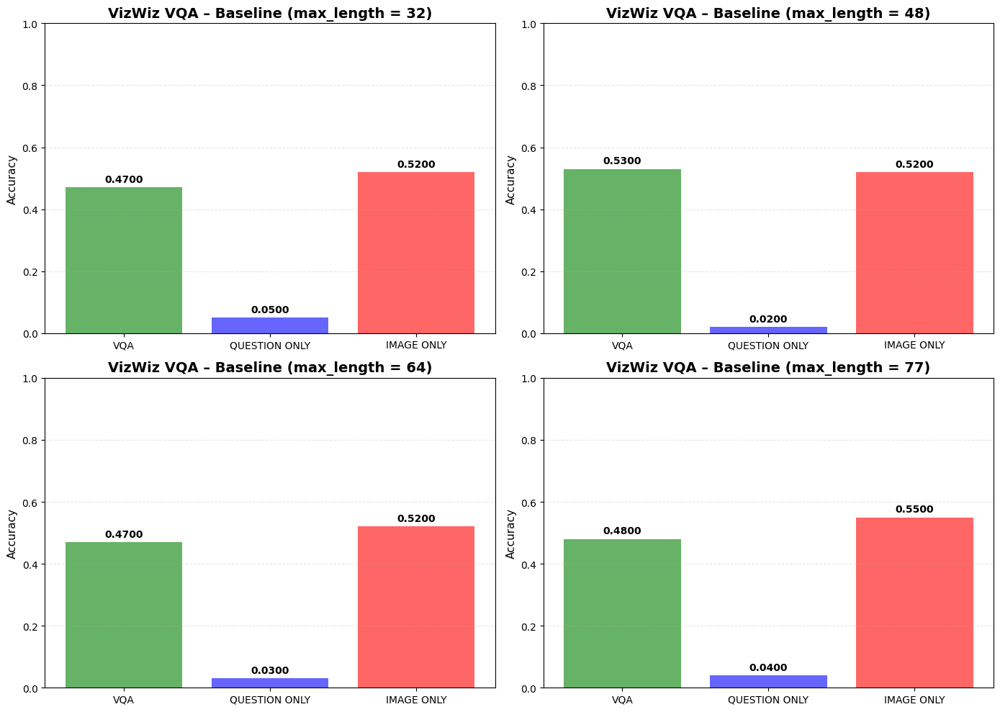

In [278]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 2, figsize=(14, 10))
axes = axes.flatten()

for i, ax in enumerate(axes):

    bars = ax.bar([label.upper() for label in mode_list], base_accuracies_list[i],
                   color=['g', 'b', 'r'], alpha=0.6)

    ax.set_ylabel("Accuracy", fontsize=11)
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', labelsize=10)
    ax.set_title(f"VizWiz VQA – Baseline (max_length = {max_lengths_list[i]})", fontweight='bold', fontsize=14)
    ax.grid(axis="y", linestyle="--", alpha=0.3)

    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2,
                height + 0.01,
                f"{height:.4f}",
                ha="center", va="bottom",
                fontsize=10, fontweight="bold")

plt.tight_layout()
plt.show()



En général, avec max_length = 32, 49, 64 ou 77, la configuration ‘question only’ affiche une accuracy très faible (<=0.05). Les configurations ‘vqa’ et ‘image only’ obtiennent de meilleurs résultats. La configuration ‘image only’ surpasse presque toujours ‘vqa’ en termes d’accuracy. Les meilleurs résultats avec ‘vqa’ sont obtenus avec max_length = 48. Cette valeur sera donc retenue pour la suite. Bien que les textes pris en compte ici soient généralement inférieurs à 32, nous optons pour une marge de sécurité afin de nous préparer à de futurs tests.


In [279]:
# MAX_LENGTH

base_accuracies_vqa = [base_acc[0] for base_acc in base_accuracies_list]
max_idx = np.argmax(base_accuracies_vqa)
max_length = max_lengths_list[max_idx]
print(f'---> MAX_LENGTH = {max_length}')

---> MAX_LENGTH = 48


EXEMPLE DE VISUALISATION DES RÉSULTATS DU PREMIER BATCH TEST POUR LES 3 CONFIGURATIONS

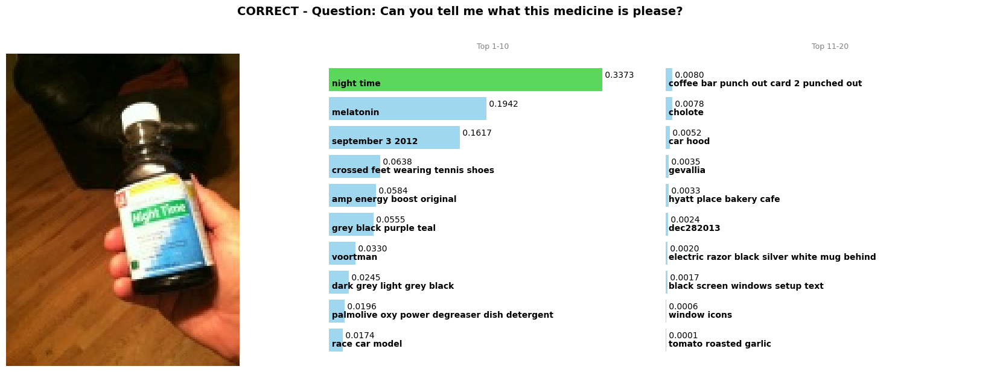

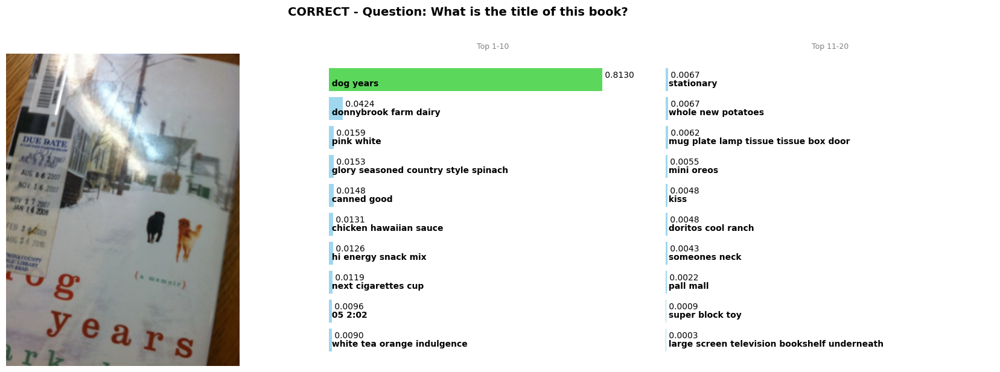

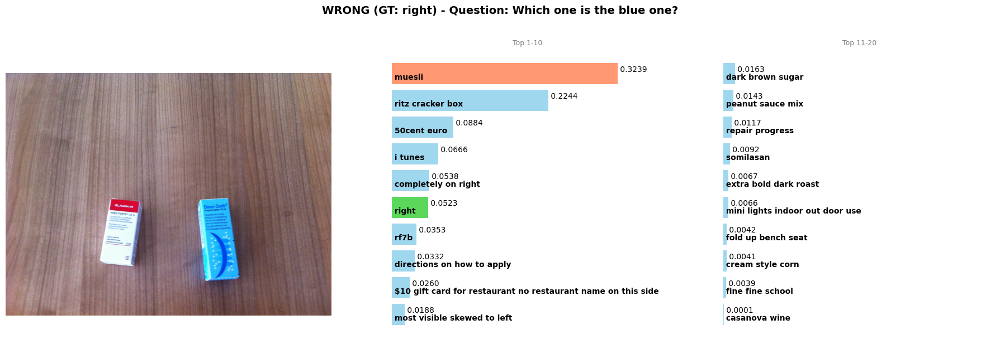

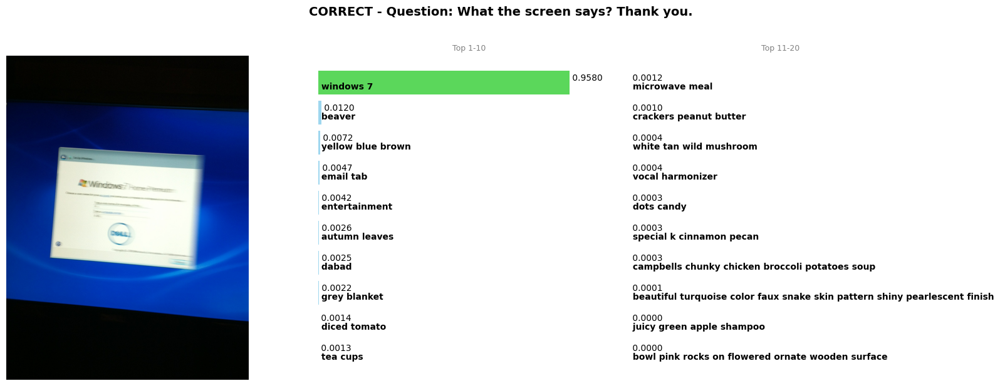

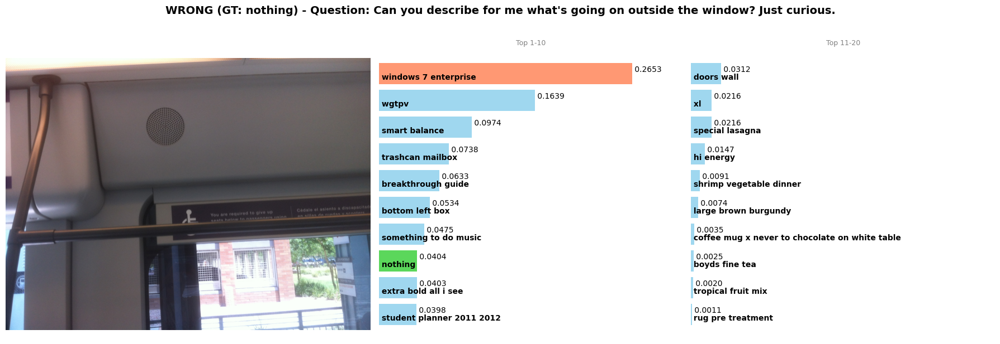

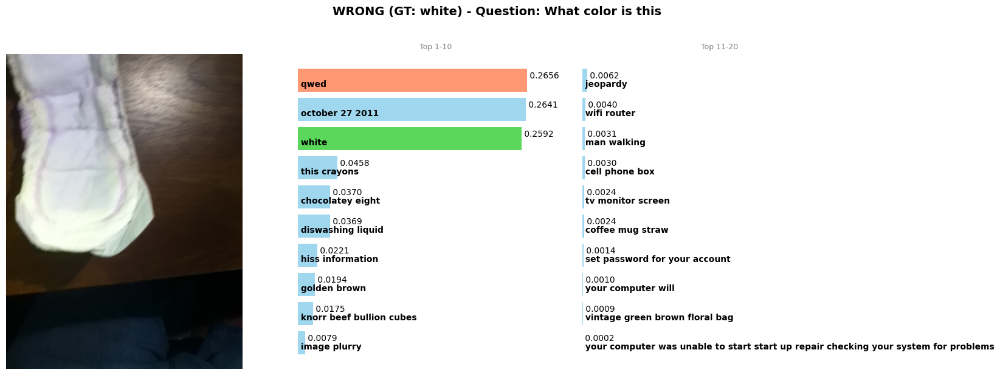

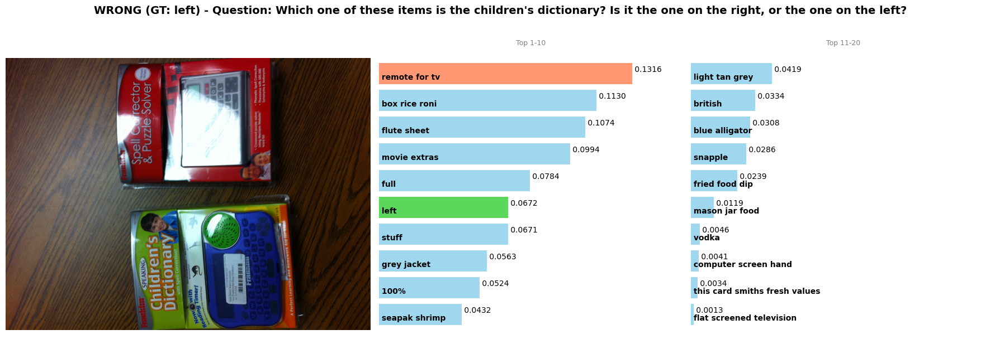

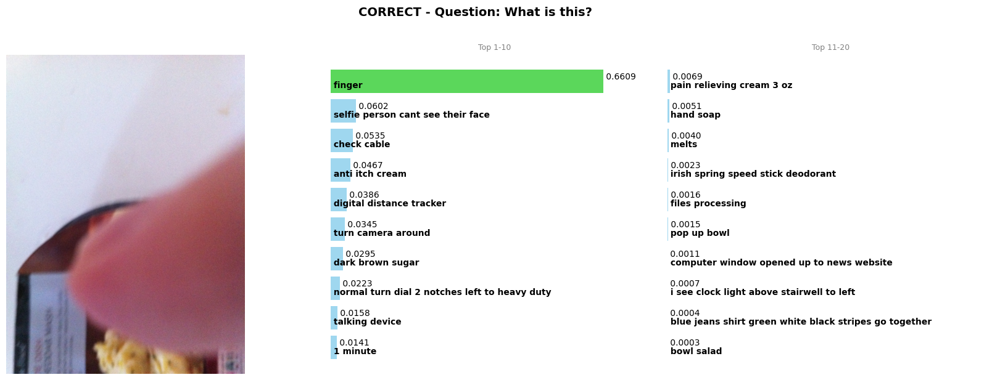

In [280]:
# VIZ VQA

# --- DATA
dataset_val = VizWizVQADataset(root_folder=root, split='val', answers_dict=all_answers_by_type,
                    mode='vqa', nb_candidates=nb_candidates, max_length=max_length, processor=processor,
                    nb_samples=8)
val_loader = DataLoader(dataset_val, batch_size=bs, shuffle=False, num_workers=0)

# --- VIZ
visualize_the_results(model, val_loader, device, temperature=None)

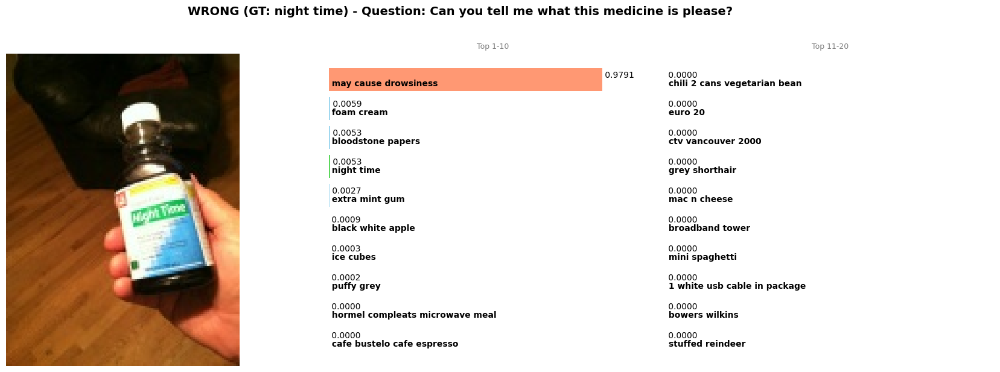

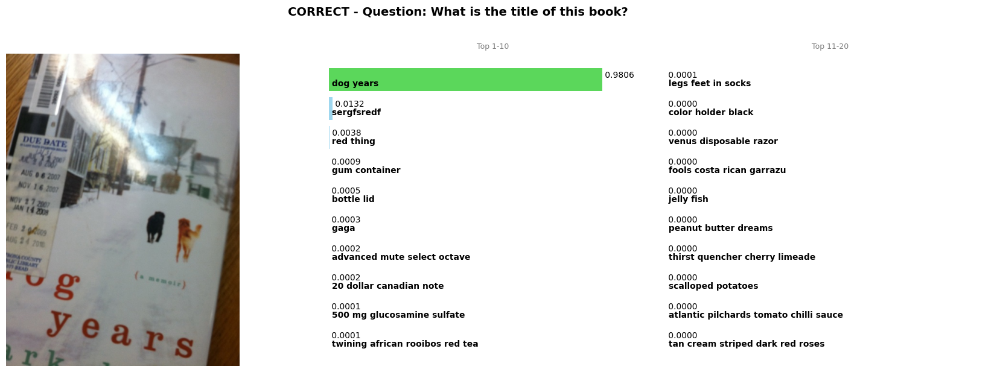

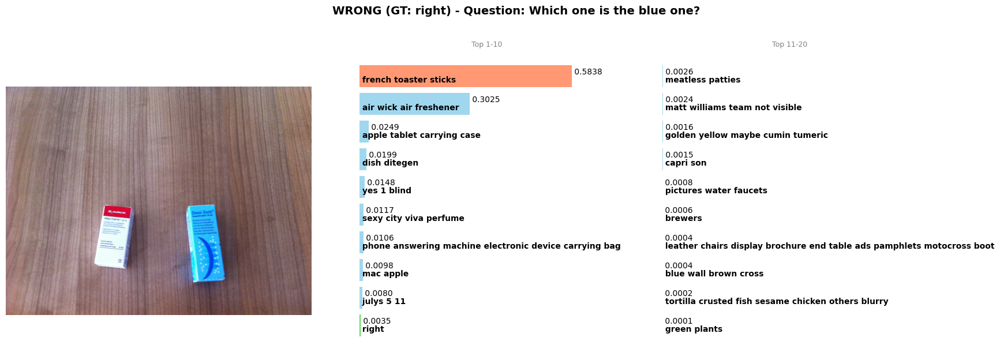

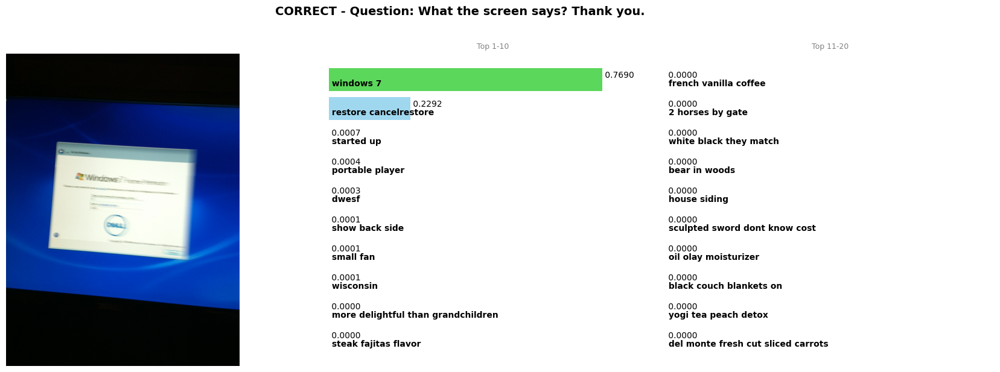

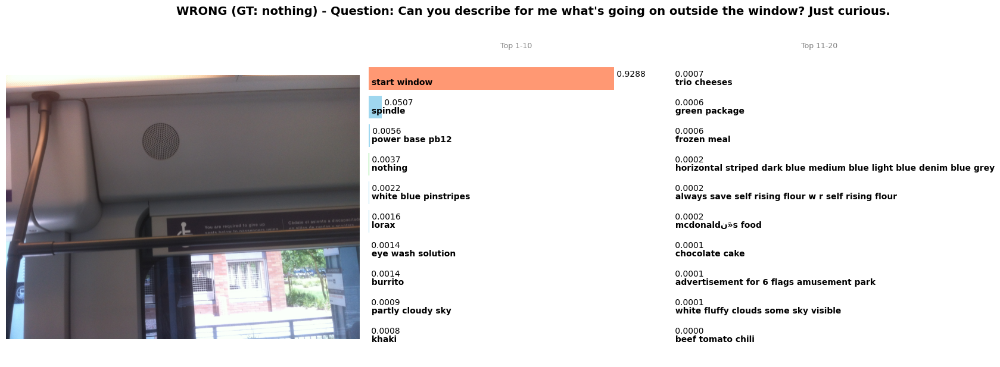

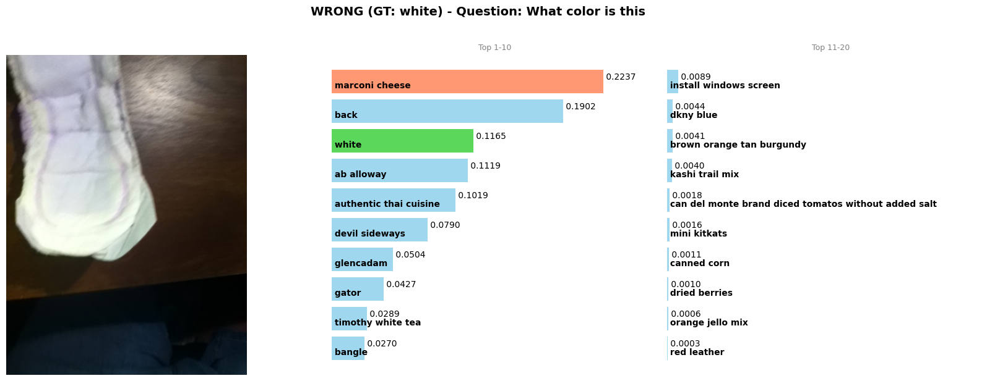

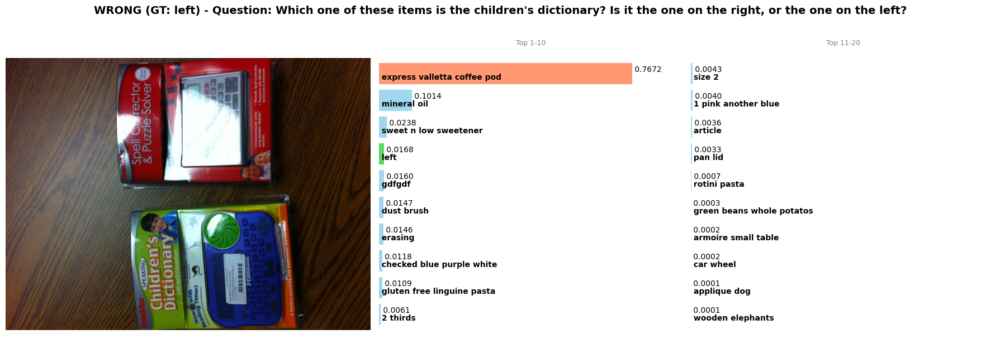

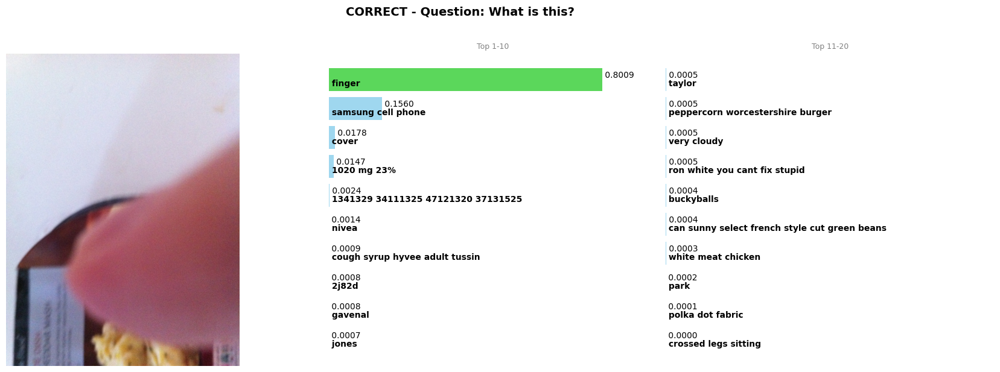

In [281]:
# VIZ IMAGE ONLY

# --- DATA
dataset_val = VizWizVQADataset(root_folder=root, split='val', answers_dict=all_answers_by_type,
                    mode='image only', nb_candidates=nb_candidates, max_length=max_length, processor=processor,
                    nb_samples=8)
val_loader = DataLoader(dataset_val, batch_size=bs, shuffle=False, num_workers=0)

# --- VIZ
visualize_the_results(model, val_loader, device, temperature=None)


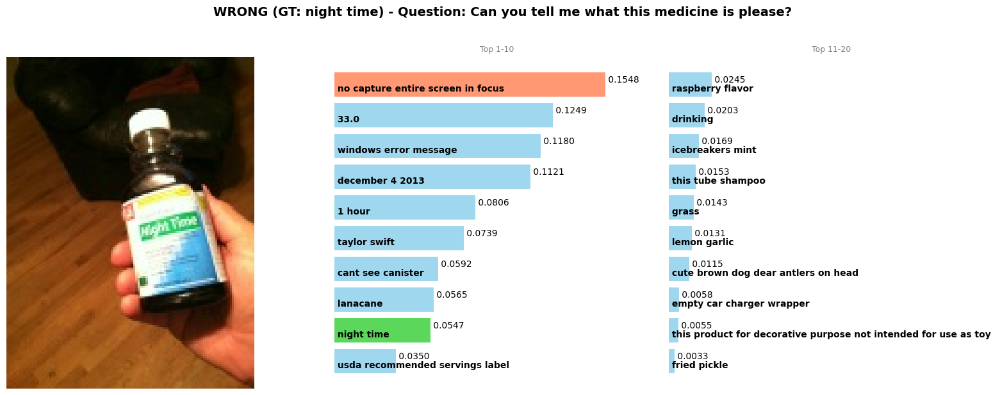

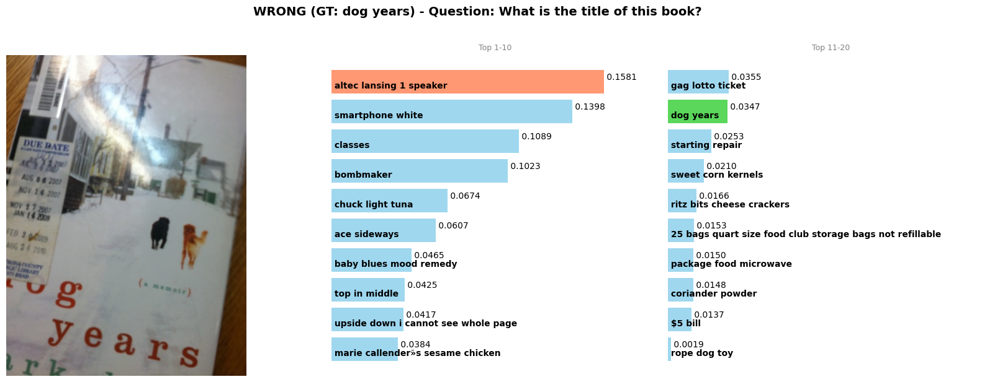

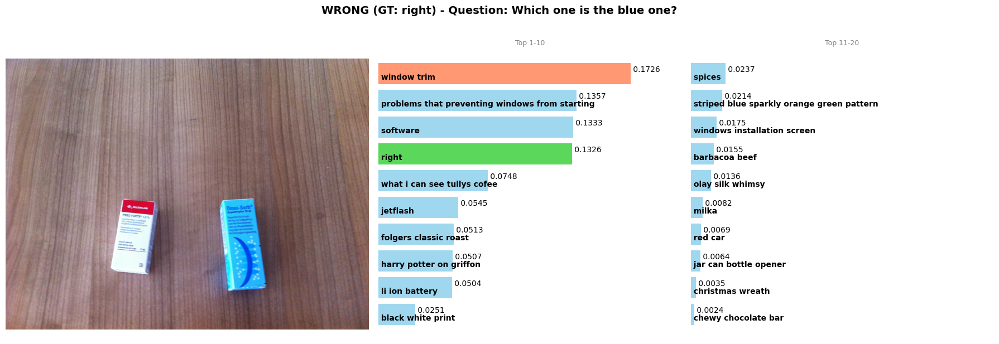

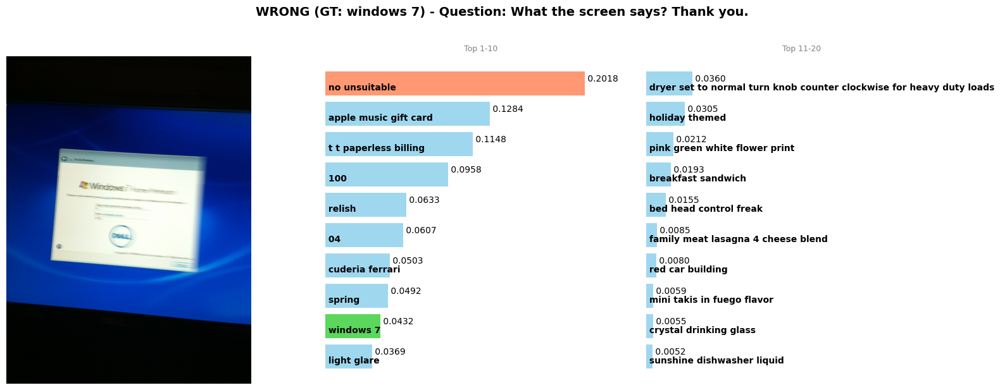

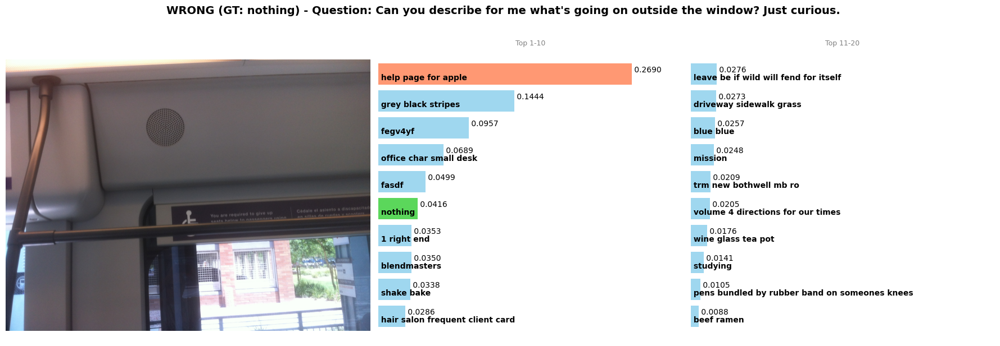

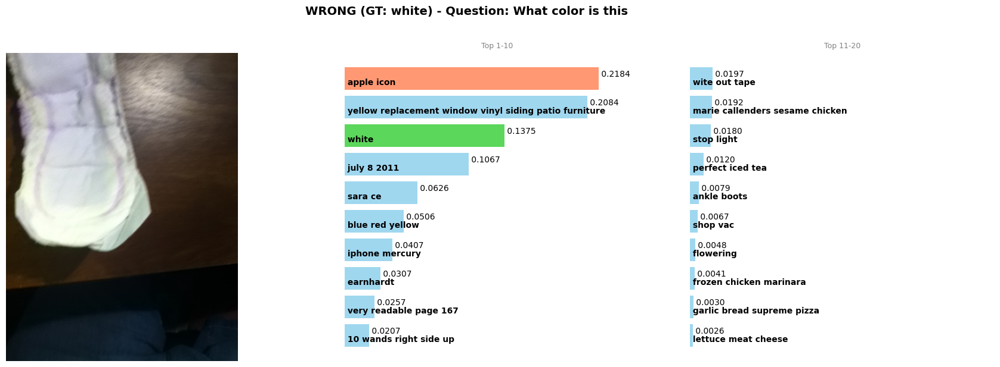

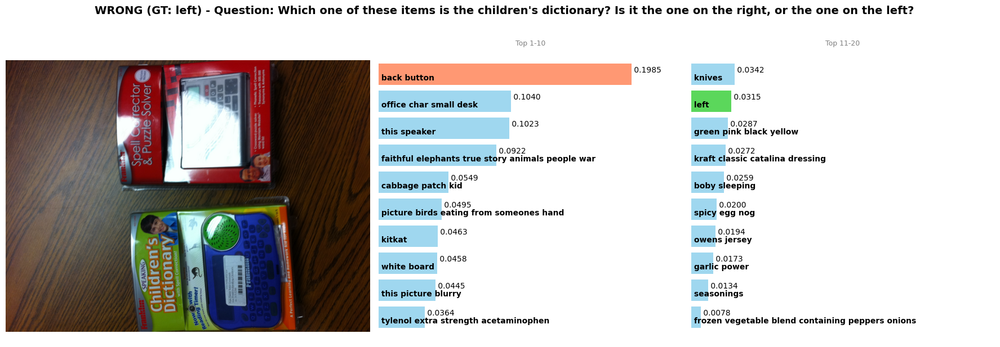

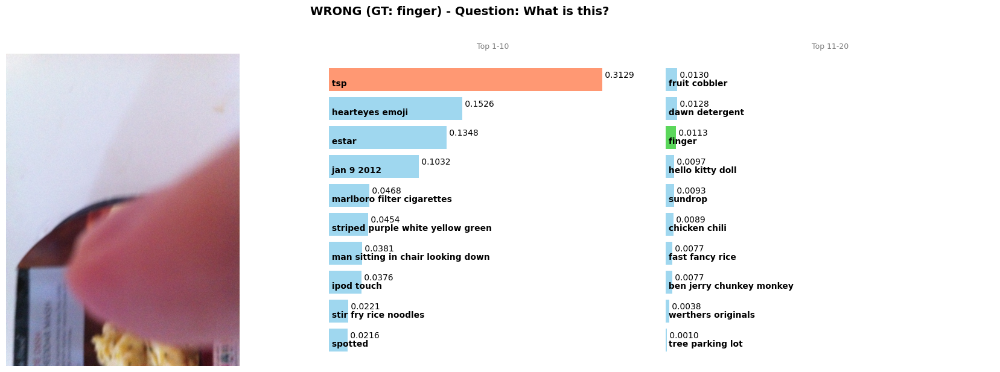

In [282]:
# VIZ QUESTION ONLY

# --- DATA
dataset_val = VizWizVQADataset(root_folder=root, split='val', answers_dict=all_answers_by_type,
                    mode='question only', nb_candidates=nb_candidates, max_length=max_length, processor=processor,
                    nb_samples=8)
val_loader = DataLoader(dataset_val, batch_size=bs, shuffle=False, num_workers=0)

# --- VIZ
visualize_the_results(model, val_loader, device, temperature=None)

**Analyse des Performances par Configuration**

L'analyse comparative des prédictions (**VQA**, **Image Only**, et **Question Only**) souligne l'importance de la multimodalité : la combinaison de l'image et du texte est indispensable pour obtenir des résultats fiables.

L'exemple du premier échantillon (Flacon 'Night Time') illustre bien la synergie entre les deux sources d'informations :

| Configuration | Prédiction | Confiance (Probabilité) | Observation |
| --- | --- | --- | --- |
| **VQA** | Correcte | **0.74** | Meilleure performance et haute certitude. |
| **Image Only** | Correcte | **0.57** | Résultat correct mais avec une hésitation marquée. |
| **Question Only** | Incorrecte | **0.05** | Prédiction éparpillée (7e position dans le classement). |

Sur l'échantillon de 8 images analysé, on peut observer la répartition suivante :

* **Configuration VQA (4/8 correctes) :** Des prédictions robustes portées par le contexte visuel et textuel.
* **Configuration Image Only (4/8 correctes) :** Score identique au VQA en termes d'exactitude, mais les probabilités varient (tantôt supérieures, tantôt inférieures à VQA).
* **Configuration Question Only (1/8 correcte) :** Performance quasi nulle, confirmant que le modèle ne peut pas "deviner" la réponse sans le support visuel.

**Conclusion : Pertinence du modèle multimodal**

La configuration **VQA** est la plus adaptée pour deux raisons principales :

* **Levée d'ambiguïté :** L'image seule (*Image Only*) permet souvent d'identifier l'objet, maissemble insuffisante dans un scénario réel où la question est indispensable pour définit le **cadre d'attention** du modèle (Par exemple, le troisième échantillon, « Which one is the blue one ? », ne fournit que la question, ce qui permet à *Question Only* de donner la bonne réponse car il n’y a qu’une seule localisation plausible parmi les propositions. En revanche, *Image Only* ne dispose pas de la question, ce qui le conduit à placer « right » en 11e position, tandis que *VQA*, qui a accès à la fois à l’image et à la question, place « right » en 4e position.)

* **Transition vers un modèle génératif :** Contrairement à un test sur 20 choix prédéfinis, une application concrète nécessite de générer une réponse libre. Sans la question pour guider cette génération, le modèle ne peut donc pas extraire l'information spécifique attendue parmi la multitude de détails visuels présents.

**Conclusion :** La surperformance de *Image Only* par rapport à *VQA* doit être nuancée, car la présence de 20 réponses candidates facilite la sélection de la réponse correcte.  L’image fournit la preuve, tandis que la question offre le cadre.  La combinaison des deux est donc essentielle pour garantir la précision et la pertinence des réponses générées.


# 3. FINETUNING

## Fine-tuning avec apprentissage contrastif

Pour des raisons de ressources computationnelles, nous n’utilisons pas l’intégralité du dataset.
Nous choisissons **400 exemples pour l’entraînement** et **100 exemples pour l’évaluation**, en conservant **les 20 candidats par paire (question, image)**.

Concernant `max_length`, nous prenons **la valeur ayant donné les meilleurs résultats en baseline sur VizWiz VQA** (sur tout le dataset), en privilégiant la plus petite en cas d’égalité -> `MAX_LENGTH = 48`.


In [14]:
# PARAMETERS

MAX_LENGTH = 48
NB_CANDIDATES = 20
BS = 8
ROOT = './data/'
MODE = 'vqa'


## DATA

In [ ]:
from torch.utils.data import DataLoader
from transformers import CLIPProcessor

processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# DATA
dataset_train = VizWizVQADataset(
    root_folder=ROOT,
    split='train',
    answers_dict=all_answers_by_type,
    mode=MODE,
    nb_candidates=NB_CANDIDATES,
    max_length=MAX_LENGTH,
    processor=processor,
    nb_samples=NB_TRAIN_SAMPLES
    )
dataset_val = VizWizVQADataset(
    root_folder=ROOT,
    split='val',
    answers_dict=all_answers_by_type,
    mode=MODE,
    nb_candidates=NB_CANDIDATES,
    max_length=MAX_LENGTH,
    processor=processor,
    nb_samples=NB_VAL_SAMPLES
    )

train_loader = DataLoader(dataset_train, batch_size=BS, shuffle=True, num_workers=0)
val_loader = DataLoader(dataset_val, batch_size=BS, shuffle=False, num_workers=0)

In [285]:
print(f'len(dataset_train) = {len(dataset_train)}')
print(f'len(dataset_val) = {len(dataset_val)}')
print(f'len(train_loader) = {len(train_loader)}')
print(f'len(val_loader) = {len(val_loader)}')

len(dataset_train) = 400
len(dataset_val) = 100
len(train_loader) = 50
len(val_loader) = 13


In [286]:
# device selection: cuda > mps > cpu
if torch.cuda.is_available():
    device = torch.device("cuda")
elif getattr(torch.backends, "mps", None) is not None \
    and torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print("Device:", device)

Device: mps


## UTILS FUNCTIONS

In [20]:
import torch
import torch.nn.functional as F
from torch.nn.functional import cosine_similarity

def train_loop(model, train_loader, epoch, temperature, device, 
               criterion, optimizer, scheduler=None, log=None):

    model = model.to(device)

    model.train()
    total_samples = 0
    total_loss = 0.0
    total_correct = 0

    for i, batch in enumerate(train_loader):

        pixel_values = batch["pixel_values"].to(device)        # [B, 3, 224, 224]
        input_ids = batch["input_ids"].to(device)              # [B, C, L]
        attention_mask = batch["attention_mask"].to(device)    # [B, C, L]
        labels = batch["label"].to(device)                     # [B]

        B, C, L = input_ids.shape

        # === Image embeddings ===
        image_embeds = model.get_image_features(pixel_values)  # [B, D]
        image_embeds = image_embeds.unsqueeze(1)               # [B, 1, D]

        # === Text embeddings ===
        flat_input_ids = input_ids.view(B * C, L)
        flat_attention_mask = attention_mask.view(B * C, L)

        text_embeds = model.get_text_features(flat_input_ids, attention_mask=flat_attention_mask)   # [B*C, D]
        text_embeds = text_embeds.view(B, C, -1)                                                    # [B, C, D]

        # === Similarity & loss ===
        similarities = cosine_similarity(image_embeds, text_embeds, dim=-1)  # [B, C]
        # Bonne pratique, pour amplifier la séparation -> temperature
        # CLIP : temp = 0.07, recommandé pour Fine-Tuning : 0.05 – 0.2
        similarities = similarities / temperature 
        loss = criterion(similarities, labels) # prends des logits buts (sans softmax, car fait en interne)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if scheduler is not None:
            scheduler.step()

        total_loss += loss.item()
        total_samples += B

        preds = similarities.argmax(dim=1)
        total_correct += (preds == labels).sum().item()

        if log is not None and (i % 10 == 0 or i == len(train_loader) - 1):
            logger.info(
                f"Epoch {epoch+1} | "
                f"Batch {i}/{len(train_loader)-1} | "
                f"Running loss: {total_loss / total_samples:.4f} | "
                f"Running accuracy: {total_correct / total_samples:.4f}"
            )

    train_loss = total_loss / total_samples
    train_accuracy = total_correct / total_samples

    return model, train_loss, train_accuracy


In [21]:
def val_loop(model, val_loader, epoch, temperature, device, criterion, log=None):

    model = model.to(device)
    model.eval()  # mode évaluation

    total_samples = 0
    total_correct = 0
    total_loss = 0.0
    n = len(val_loader)

    with torch.no_grad():

        for i, batch in enumerate(val_loader):

            pixel_values = batch["pixel_values"].to(device)         # [B, 3, 224, 224]
            input_ids = batch["input_ids"].to(device)               # [B, num_candidates, seq_len]
            attention_mask = batch["attention_mask"].to(device)     # [B, num_candidates, seq_len]
            labels = batch["label"].to(device)                      # [B]

            B, C, L = input_ids.shape                               # B, C->num_candidates, L-> seq_len

            # Aplatir les candidats pour passer au modèle
            flat_input_ids = input_ids.view(B * C, L)               # [B * C, L]
            flat_attention_mask = attention_mask.view(B * C, L)     # [B * C, L]

            # Embeddings texte
            text_embeds = model.get_text_features(flat_input_ids, attention_mask=flat_attention_mask)
            text_embeds = text_embeds.view(B, C, -1)                # [B, C, hidden_size]

            # Embedding image
            image_embeds = model.get_image_features(pixel_values)  # [B, hidden_size]
            image_embeds = image_embeds.unsqueeze(1)               # [B, 1, hidden_size]

            # Similarité cosinus :
            similarities = cosine_similarity(image_embeds, text_embeds, dim=-1) # [B, num_candidates]
            if temperature != None:
                similarities = similarities / temperature
            else: # CLIP on basic config
                scale = model.logit_scale().exp()
                similarities = similarities * scale

            # Loss
            loss = criterion(similarities, labels)

            # Prédiction : indice du candidat le plus similaire
            preds = similarities.argmax(dim=1)

            # Calcul précision
            total_correct += (preds == labels).sum().item()
            total_samples += B
            total_loss += loss.item()

            if log is not None and epoch is not None and ((i % 3) == 0 or i == (n - 1)):
                logger.info(
                    f"Epoch {epoch+1} | "
                    f"Batch {i}/{len(val_loader)-1} | "
                    f"Running loss: {total_loss / total_samples:.4f} | "
                    f"Running accuracy: {total_correct / total_samples:.4f}"
                )

    val_loss = total_loss / total_samples
    val_accuracy = total_correct / total_samples
    
    return val_loss, val_accuracy


## SANS FINETUNING

In [289]:
# --- MODEL
from transformers import CLIPModel
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")

# --- EVAL
base_acc = eval_loop(model, val_loader, device, temperature=None, log=True)
logger.info(f'Accuracy : {base_acc:.4f}')

2026-01-30 19:41:49.023 | INFO     | __main__:eval_loop:53 - Batch 0/12 	 running_accuracy = 0.3750
2026-01-30 19:41:49.922 | INFO     | __main__:eval_loop:53 - Batch 3/12 	 running_accuracy = 0.4062
2026-01-30 19:41:50.855 | INFO     | __main__:eval_loop:53 - Batch 6/12 	 running_accuracy = 0.3929
2026-01-30 19:41:51.717 | INFO     | __main__:eval_loop:53 - Batch 9/12 	 running_accuracy = 0.4000
2026-01-30 19:41:52.452 | INFO     | __main__:eval_loop:53 - Batch 12/12 	 running_accuracy = 0.4000
2026-01-30 19:41:52.452 | INFO     | __main__:<module>:7 - Accuracy : 0.4000


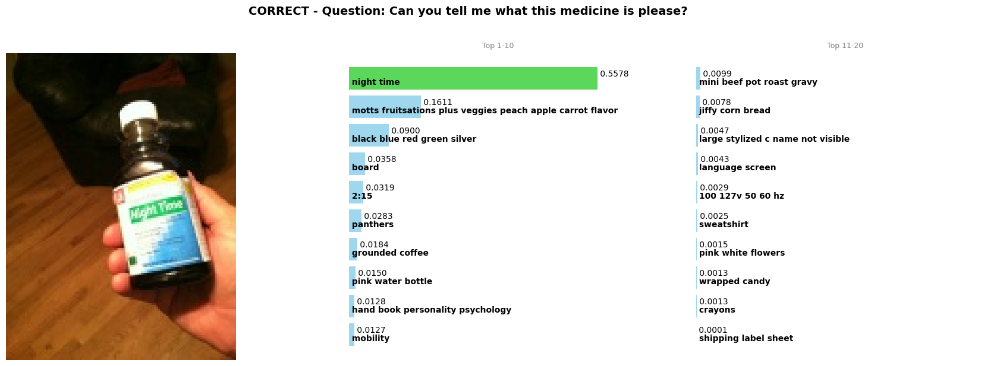

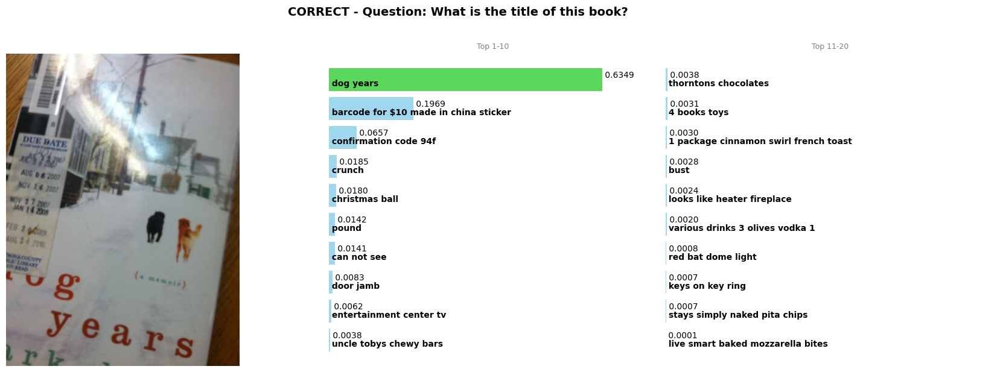

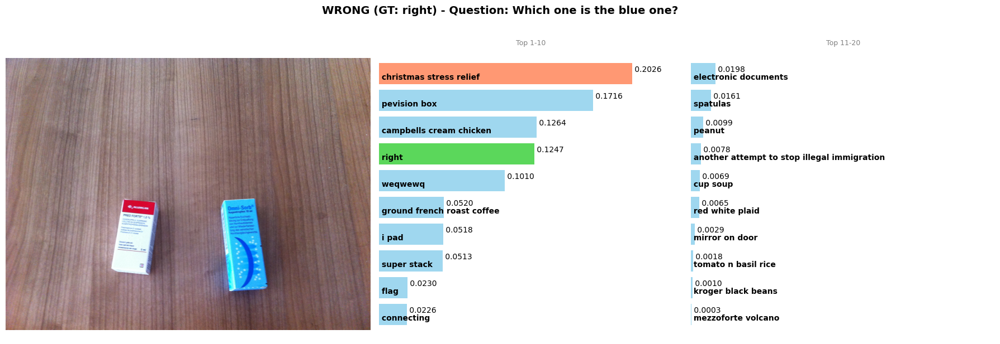

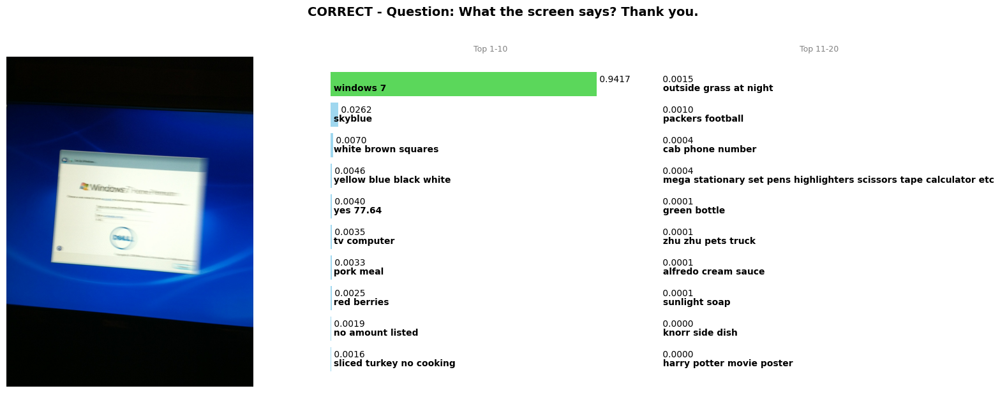

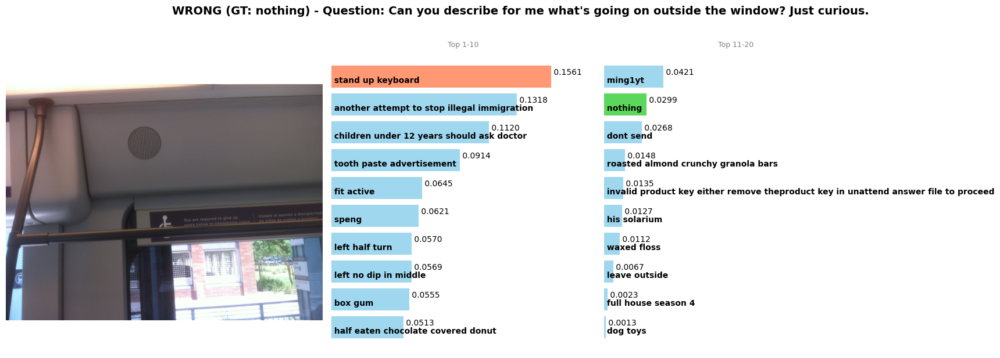

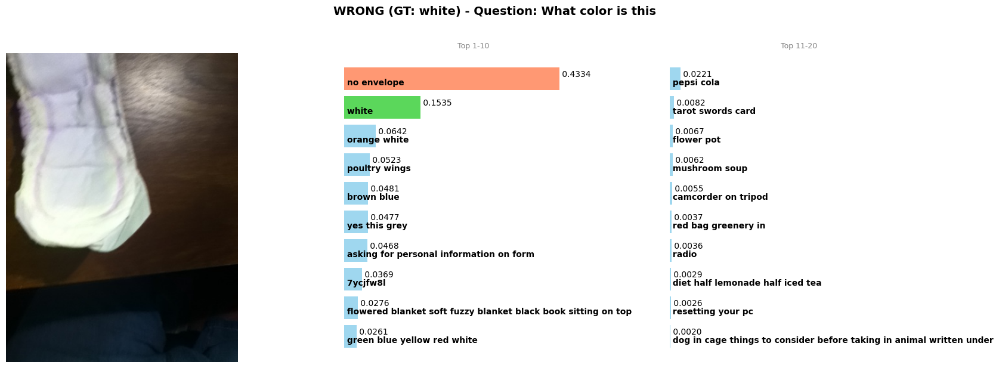

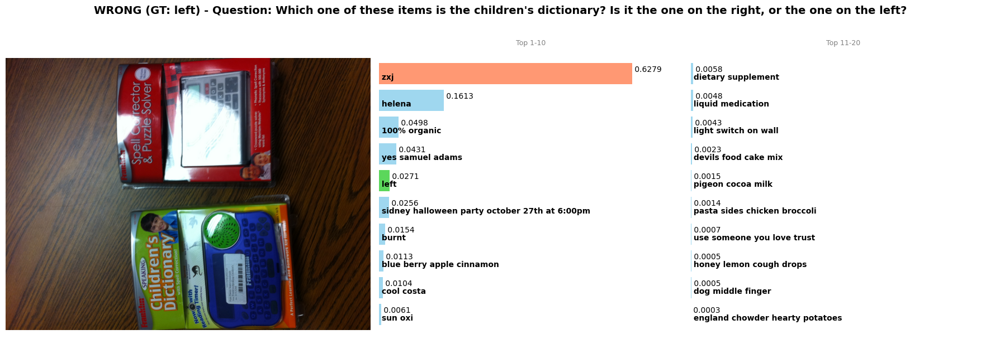

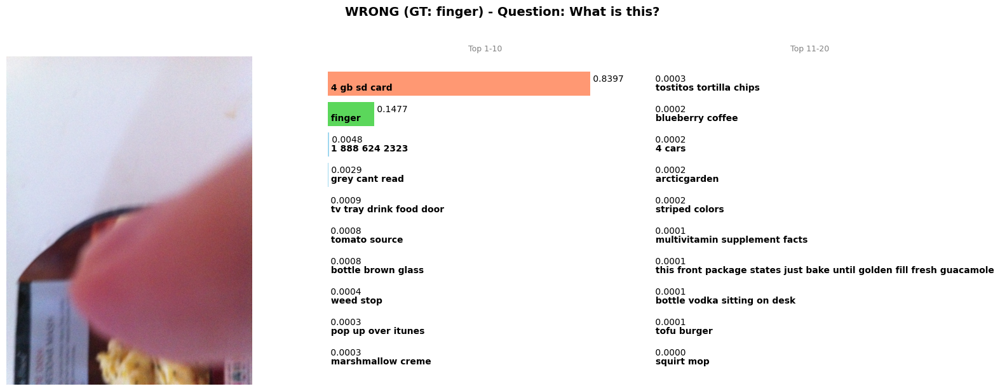

In [ ]:
visualize_the_results(model, val_loader, device, temperature=None)

## AVEC FINETUNING

In [292]:
if __name__ == "__main__":

    lr = 1e-6
    epochs = 20
    temp = 0.07

    model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
    criterion = torch.nn.CrossEntropyLoss(reduction='sum')        # pour calculer la somme des loss sur le batch (pas la moy)
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    # LR Scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=1)

    # Early stopping
    best_val_loss = float('inf')
    patience_es = 2
    counter_es = 0
    stoped_epoch = -1
    best_path = f"best_clip{MAX_LENGTH}.pth"

    train_losses, val_losses = [], []
    train_accuracies, val_accuracies = [], []

    for epoch in range(epochs):

        logger.info(f'\nEPOCH {epoch+1}/{epochs}')
        logger.info(f'----- TRAINING LOOP {epoch+1}/{epochs}')
        model, train_loss, train_accuracy = train_loop(model, train_loader, epoch, temp, device, criterion, \
                                                       optimizer, scheduler=None, log=True)
        logger.info(f"### [TRAIN {epoch+1}/{epochs}] Train loss: {train_loss:.4f} | Train acc: {train_accuracy:.4f}")
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)

        logger.info(f'----- VALIDATION LOOP {epoch+1}/{epochs}')
        val_loss, val_accuracy = val_loop(model, val_loader, epoch, temp, device, criterion, log=True)
        logger.info(f"### [TEST {epoch+1}/{epochs}] Val loss: {val_loss:.4f} | Val acc: {val_accuracy:.4f}")
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        scheduler.step(val_loss)

        # early stopping & save best
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            counter_es = 0
            torch.save(model.state_dict(), best_path)
            print(f"  -> meilleur modèle sauvegardé (val_loss={best_val_loss:.4f})")
        else:
            counter_es += 1
            if counter_es >= patience_es:
                print(f"Early stopping (no improvement for {patience_es} epochs).")
                stoped_epoch = epoch
                break

    # charger meilleur modèle
    if os.path.exists(best_path):
        model.load_state_dict(torch.load(best_path, map_location=device))
        print("Meilleur modèle chargé depuis", best_path)

    # Évaluation finale sur test set
    test_loss, test_acc = val_loop(model, val_loader, epoch, temp, device, criterion, log=False)
    logger.info(f"[FINAL TEST] Test Loss: {test_loss:.4f}, Acc: {test_acc:.4f}")


2026-01-30 19:45:05.051 | INFO     | __main__:<module>:26 - 
EPOCH 1/20
2026-01-30 19:45:05.051 | INFO     | __main__:<module>:27 - ----- TRAINING LOOP 1/20
2026-01-30 19:45:07.453 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 0/49 | Running loss: 2.4416 | Running accuracy: 0.5000
2026-01-30 19:45:14.947 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 10/49 | Running loss: 2.3454 | Running accuracy: 0.5795
2026-01-30 19:45:22.231 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 20/49 | Running loss: 2.2918 | Running accuracy: 0.5952
2026-01-30 19:45:29.470 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 30/49 | Running loss: 2.2832 | Running accuracy: 0.5645
2026-01-30 19:45:36.707 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 40/49 | Running loss: 2.2060 | Running accuracy: 0.6006
2026-01-30 19:45:43.291 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 49/49 | Running loss: 2.1675 | Running accuracy: 0.5975
2026-01-30 19:45:43.292 | INFO     | __m

  -> meilleur modèle sauvegardé (val_loss=2.1359)


2026-01-30 19:45:48.604 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 0/49 | Running loss: 1.4296 | Running accuracy: 1.0000
2026-01-30 19:45:55.920 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 10/49 | Running loss: 1.5853 | Running accuracy: 0.7955
2026-01-30 19:46:03.137 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 20/49 | Running loss: 1.5046 | Running accuracy: 0.8155
2026-01-30 19:46:10.383 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 30/49 | Running loss: 1.4580 | Running accuracy: 0.8145
2026-01-30 19:46:17.756 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 40/49 | Running loss: 1.4019 | Running accuracy: 0.8079
2026-01-30 19:46:24.364 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 49/49 | Running loss: 1.3773 | Running accuracy: 0.8050
2026-01-30 19:46:24.365 | INFO     | __main__:<module>:30 - ### [TRAIN 2/20] Train loss: 1.3773 | Train acc: 0.8050
2026-01-30 19:46:24.365 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=1.7760)


2026-01-30 19:46:29.555 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 0/49 | Running loss: 0.8098 | Running accuracy: 1.0000
2026-01-30 19:46:36.963 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 10/49 | Running loss: 0.9426 | Running accuracy: 0.9432
2026-01-30 19:46:44.354 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 20/49 | Running loss: 0.8553 | Running accuracy: 0.9524
2026-01-30 19:46:51.741 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 30/49 | Running loss: 0.8367 | Running accuracy: 0.9274
2026-01-30 19:46:59.123 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 40/49 | Running loss: 0.7814 | Running accuracy: 0.9421
2026-01-30 19:47:05.730 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 49/49 | Running loss: 0.7694 | Running accuracy: 0.9500
2026-01-30 19:47:05.730 | INFO     | __main__:<module>:30 - ### [TRAIN 3/20] Train loss: 0.7694 | Train acc: 0.9500
2026-01-30 19:47:05.731 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=1.5668)


2026-01-30 19:47:10.992 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 0/49 | Running loss: 0.5710 | Running accuracy: 1.0000
2026-01-30 19:47:18.387 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 10/49 | Running loss: 0.4943 | Running accuracy: 0.9773
2026-01-30 19:47:25.624 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 20/49 | Running loss: 0.4336 | Running accuracy: 0.9881
2026-01-30 19:47:32.985 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 30/49 | Running loss: 0.4430 | Running accuracy: 0.9879
2026-01-30 19:47:40.341 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 40/49 | Running loss: 0.4309 | Running accuracy: 0.9909
2026-01-30 19:47:46.932 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 49/49 | Running loss: 0.4246 | Running accuracy: 0.9900
2026-01-30 19:47:46.933 | INFO     | __main__:<module>:30 - ### [TRAIN 4/20] Train loss: 0.4246 | Train acc: 0.9900
2026-01-30 19:47:46.934 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=1.4681)


2026-01-30 19:47:52.111 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 0/49 | Running loss: 0.3641 | Running accuracy: 1.0000
2026-01-30 19:47:59.462 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 10/49 | Running loss: 0.2827 | Running accuracy: 1.0000
2026-01-30 19:48:06.827 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 20/49 | Running loss: 0.2789 | Running accuracy: 1.0000
2026-01-30 19:48:14.058 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 30/49 | Running loss: 0.2645 | Running accuracy: 1.0000
2026-01-30 19:48:21.294 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 40/49 | Running loss: 0.2587 | Running accuracy: 1.0000
2026-01-30 19:48:27.771 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 49/49 | Running loss: 0.2471 | Running accuracy: 1.0000
2026-01-30 19:48:27.772 | INFO     | __main__:<module>:30 - ### [TRAIN 5/20] Train loss: 0.2471 | Train acc: 1.0000
2026-01-30 19:48:27.772 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=1.4112)


2026-01-30 19:48:33.002 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 0/49 | Running loss: 0.0904 | Running accuracy: 1.0000
2026-01-30 19:48:40.245 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 10/49 | Running loss: 0.1489 | Running accuracy: 1.0000
2026-01-30 19:48:47.436 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 20/49 | Running loss: 0.1549 | Running accuracy: 1.0000
2026-01-30 19:48:54.938 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 30/49 | Running loss: 0.1479 | Running accuracy: 1.0000
2026-01-30 19:49:02.147 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 40/49 | Running loss: 0.1514 | Running accuracy: 1.0000
2026-01-30 19:49:08.712 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 49/49 | Running loss: 0.1545 | Running accuracy: 1.0000
2026-01-30 19:49:08.713 | INFO     | __main__:<module>:30 - ### [TRAIN 6/20] Train loss: 0.1545 | Train acc: 1.0000
2026-01-30 19:49:08.713 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=1.3723)


2026-01-30 19:49:13.935 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 0/49 | Running loss: 0.0643 | Running accuracy: 1.0000
2026-01-30 19:49:21.230 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 10/49 | Running loss: 0.1067 | Running accuracy: 1.0000
2026-01-30 19:49:28.511 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 20/49 | Running loss: 0.1026 | Running accuracy: 1.0000
2026-01-30 19:49:35.713 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 30/49 | Running loss: 0.1040 | Running accuracy: 1.0000
2026-01-30 19:49:43.019 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 40/49 | Running loss: 0.1056 | Running accuracy: 1.0000
2026-01-30 19:49:49.525 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 49/49 | Running loss: 0.1063 | Running accuracy: 1.0000
2026-01-30 19:49:49.526 | INFO     | __main__:<module>:30 - ### [TRAIN 7/20] Train loss: 0.1063 | Train acc: 1.0000
2026-01-30 19:49:49.526 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=1.3636)


2026-01-30 19:49:54.673 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 0/49 | Running loss: 0.0645 | Running accuracy: 1.0000
2026-01-30 19:50:01.937 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 10/49 | Running loss: 0.0875 | Running accuracy: 1.0000
2026-01-30 19:50:09.218 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 20/49 | Running loss: 0.0788 | Running accuracy: 1.0000
2026-01-30 19:50:16.427 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 30/49 | Running loss: 0.0786 | Running accuracy: 1.0000
2026-01-30 19:50:23.655 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 40/49 | Running loss: 0.0770 | Running accuracy: 1.0000
2026-01-30 19:50:30.313 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 49/49 | Running loss: 0.0784 | Running accuracy: 1.0000
2026-01-30 19:50:30.313 | INFO     | __main__:<module>:30 - ### [TRAIN 8/20] Train loss: 0.0784 | Train acc: 1.0000
2026-01-30 19:50:30.313 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=1.3548)


2026-01-30 19:50:35.683 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 0/49 | Running loss: 0.0445 | Running accuracy: 1.0000
2026-01-30 19:50:42.965 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 10/49 | Running loss: 0.0570 | Running accuracy: 1.0000
2026-01-30 19:50:50.220 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 20/49 | Running loss: 0.0577 | Running accuracy: 1.0000
2026-01-30 19:50:57.563 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 30/49 | Running loss: 0.0579 | Running accuracy: 1.0000
2026-01-30 19:51:04.835 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 40/49 | Running loss: 0.0601 | Running accuracy: 1.0000
2026-01-30 19:51:11.398 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 49/49 | Running loss: 0.0598 | Running accuracy: 1.0000
2026-01-30 19:51:11.399 | INFO     | __main__:<module>:30 - ### [TRAIN 9/20] Train loss: 0.0598 | Train acc: 1.0000
2026-01-30 19:51:11.399 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=1.3478)


2026-01-30 19:51:16.644 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 0/49 | Running loss: 0.0412 | Running accuracy: 1.0000
2026-01-30 19:51:24.132 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 10/49 | Running loss: 0.0472 | Running accuracy: 1.0000
2026-01-30 19:51:31.465 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 20/49 | Running loss: 0.0451 | Running accuracy: 1.0000
2026-01-30 19:51:38.754 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 30/49 | Running loss: 0.0465 | Running accuracy: 1.0000
2026-01-30 19:51:46.066 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 40/49 | Running loss: 0.0477 | Running accuracy: 1.0000
2026-01-30 19:51:52.600 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 49/49 | Running loss: 0.0475 | Running accuracy: 1.0000
2026-01-30 19:51:52.601 | INFO     | __main__:<module>:30 - ### [TRAIN 10/20] Train loss: 0.0475 | Train acc: 1.0000
2026-01-30 19:51:52.601 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.3454)


2026-01-30 19:52:38.307 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 0/49 | Running loss: 0.0353 | Running accuracy: 1.0000
2026-01-30 19:52:45.745 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 10/49 | Running loss: 0.0297 | Running accuracy: 1.0000
2026-01-30 19:52:53.370 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 20/49 | Running loss: 0.0370 | Running accuracy: 1.0000
2026-01-30 19:53:00.695 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 30/49 | Running loss: 0.0335 | Running accuracy: 1.0000
2026-01-30 19:53:08.149 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 40/49 | Running loss: 0.0330 | Running accuracy: 1.0000
2026-01-30 19:53:14.751 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 49/49 | Running loss: 0.0320 | Running accuracy: 1.0000
2026-01-30 19:53:14.751 | INFO     | __main__:<module>:30 - ### [TRAIN 12/20] Train loss: 0.0320 | Train acc: 1.0000
2026-01-30 19:53:14.752 | INFO     | __main__:<module>:34 - ----- VALIDATI

Early stopping (no improvement for 2 epochs).
Meilleur modèle chargé depuis best_clip48.pth


2026-01-30 19:54:00.194 | INFO     | __main__:val_loop:54 - Epoch 13 | Batch 0/12 | Running loss: 0.9193 | Running accuracy: 0.8750
2026-01-30 19:54:01.124 | INFO     | __main__:val_loop:54 - Epoch 13 | Batch 3/12 | Running loss: 1.0649 | Running accuracy: 0.8125
2026-01-30 19:54:02.112 | INFO     | __main__:val_loop:54 - Epoch 13 | Batch 6/12 | Running loss: 1.1321 | Running accuracy: 0.7500
2026-01-30 19:54:03.048 | INFO     | __main__:val_loop:54 - Epoch 13 | Batch 9/12 | Running loss: 1.2337 | Running accuracy: 0.7125
2026-01-30 19:54:03.872 | INFO     | __main__:val_loop:54 - Epoch 13 | Batch 12/12 | Running loss: 1.3454 | Running accuracy: 0.6700
2026-01-30 19:54:03.873 | INFO     | __main__:<module>:62 - [FINAL TEST] Test Loss: 1.3454, Acc: 0.6700


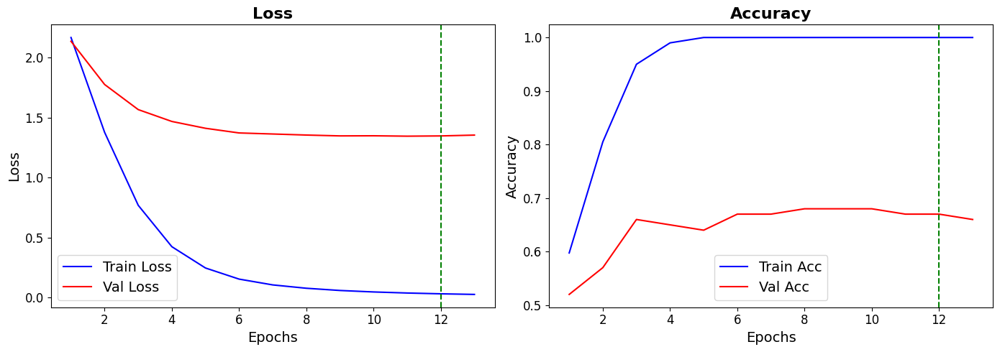

In [ ]:
# Création d'une figure avec 3 sous-graphiques côte à côte
_, axes = plt.subplots(1, 2, figsize=(14, 5))

epochs_range = range(1, len(train_losses) + 1)

# --- LOSS ---
axes[0].plot(epochs_range, train_losses, label='Train Loss', color='blue')
axes[0].plot(epochs_range, val_losses, label='Val Loss', color='red')
axes[0].set_title("Loss", fontsize=16, fontweight='bold')
axes[0].set_xlabel("Epochs", fontsize=14)
axes[0].set_ylabel("Loss", fontsize=14)
#axes[0].grid(True)
axes[0].tick_params(axis='both', labelsize=12)
axes[0].legend(fontsize=14)

# --- ACCURACY ---
axes[1].plot(epochs_range, train_accuracies, label='Train Acc', color='blue')
axes[1].plot(epochs_range, val_accuracies, label='Val Acc', color='red')
axes[1].set_title("Accuracy", fontsize=16, fontweight='bold')
axes[1].set_xlabel("Epochs", fontsize=14)
axes[1].set_ylabel("Accuracy", fontsize=14)
#axes[1].grid(True)
axes[1].tick_params(axis='both', labelsize=12)
axes[1].legend(fontsize=14)

if stoped_epoch > 0: # verify stoped_epoch != -1 default initialisation => early stopping occured
    stoped_epoch = stoped_epoch - patience_es + 1
    axes[0].axvline(x=stoped_epoch, color='green', linestyle='--')
    axes[1].axvline(x=stoped_epoch, color='green', linestyle='--', label='early stopping')

plt.tight_layout()
plt.show()
plt.close()

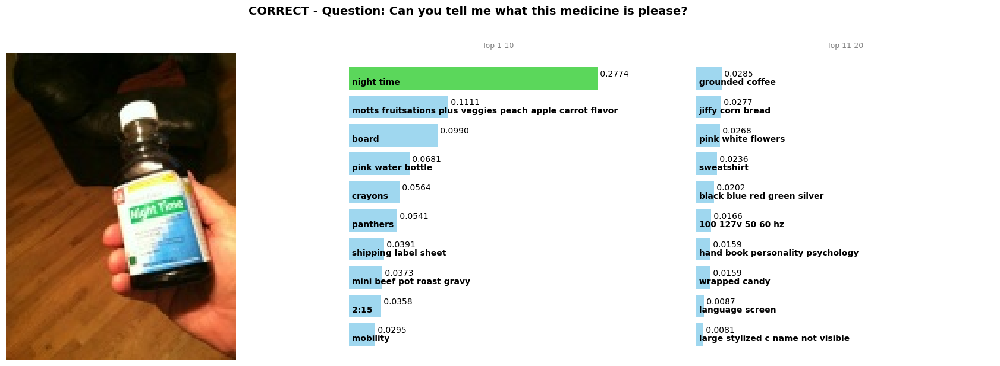

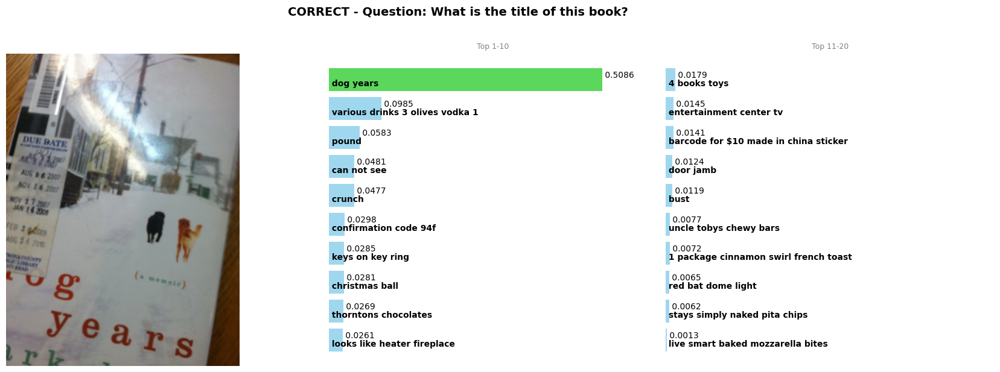

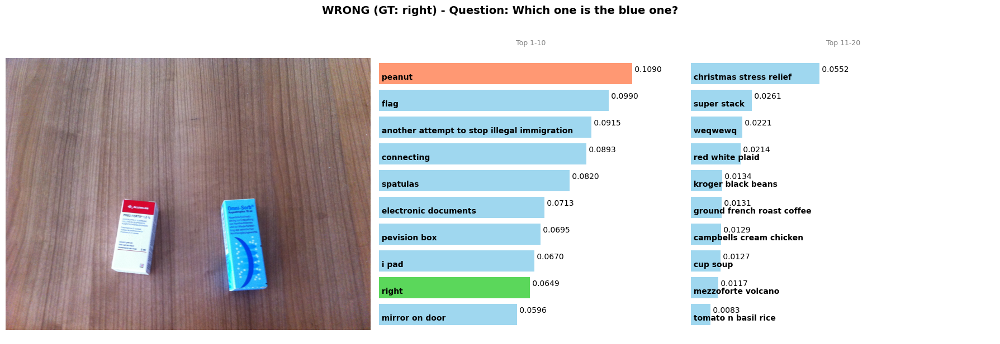

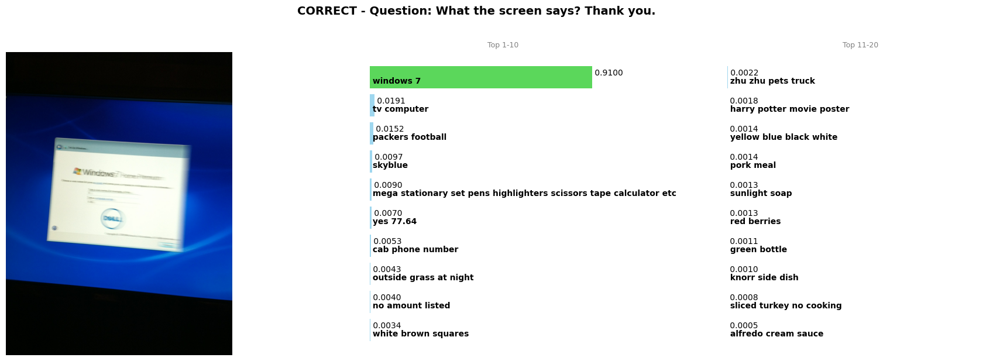

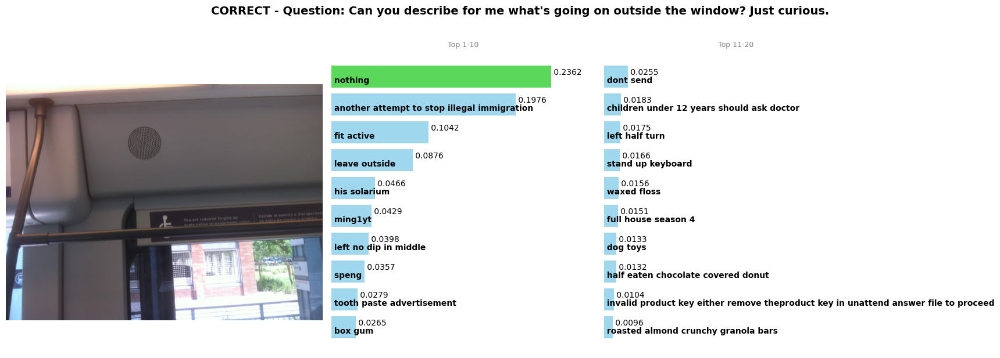

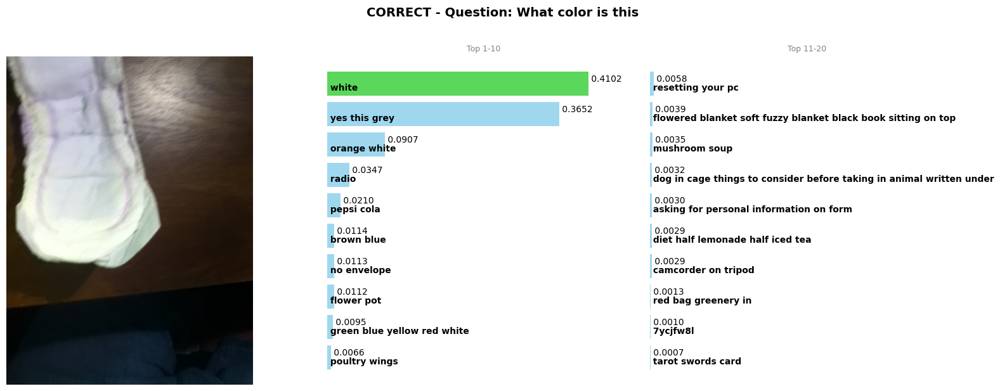

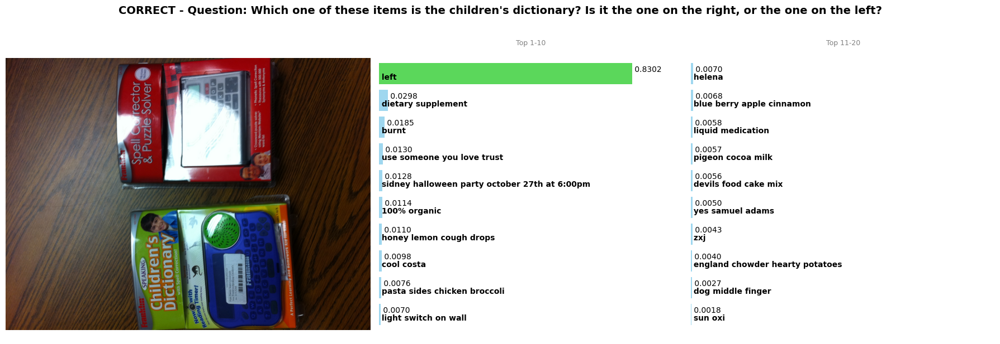

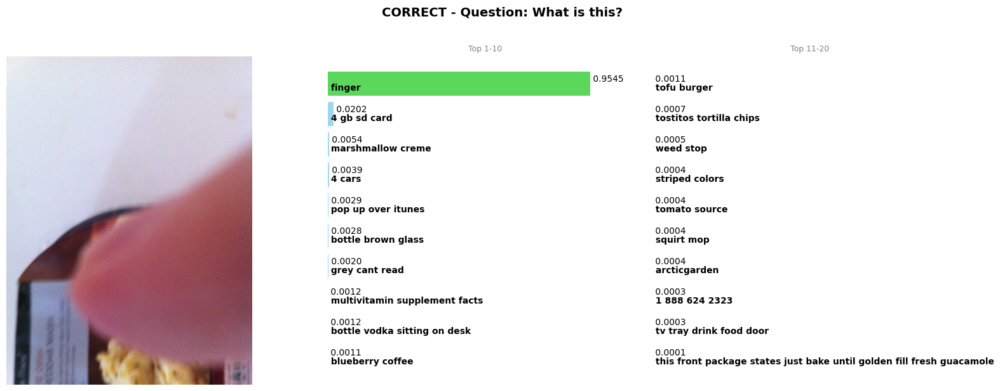

In [294]:
visualize_the_results(model, val_loader, device, temperature=temp)

## COMPARAISON

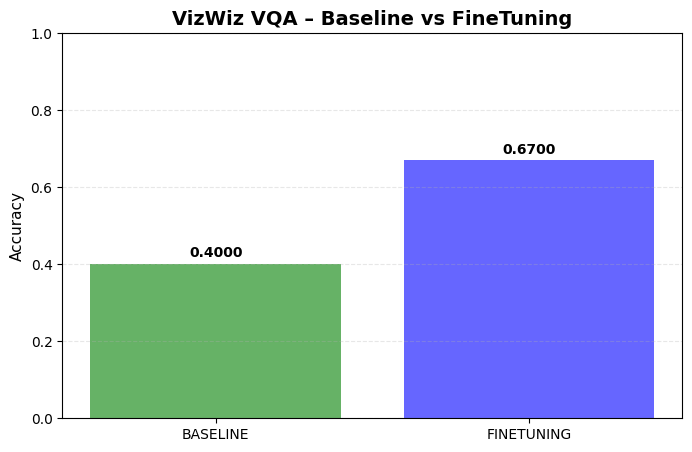

In [295]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
bars = plt.bar([label.upper() for label in ['baseline', 'finetuning']], [base_acc, test_acc],
               color=['g', 'b', 'r'], alpha=0.6)

plt.ylabel("Accuracy", fontsize=11)
plt.ylim(0, 1)
plt.xticks(fontsize=10)

plt.title("VizWiz VQA – Baseline vs FineTuning", fontweight='bold', fontsize=14)
plt.grid(axis="y", linestyle="--", alpha=0.3)

for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.01, f"{height:.4f}",
        ha="center", va="bottom", fontsize=10, fontweight="bold")

plt.show()

Avec un **fine-tuning sur seulement 400 exemples d’entraînement**, on observe déjà une **amélioration notable de l’accuracy** sur le split test. La performance progresse de **27 points de pourcentage**, passant de **0.40 à 0.67** d’accuracy.


# 4. IMPROVE QUESTION FORMULATION

Pour améliorer davantage l’accuracy, une piste consisterait à **améliorer la formulation des questions via du pré-traitement**.

Les questions du dataset **VizWiz** étant retranscrites telles qu’elles ont été formulées à l’oral par les utilisateurs, elles peuvent contenir :
- des **répétitions** (ex. "What color... what color is this skirt?") ;
- des **hésitations** ;
- des **informations inutiles** comme :
    - des remerciements : "Is this enchilada sauce or is this tomatoes?  Thank you."
    - des formules de politesse : "What flavor is this, please?".

Un nettoyage et une normalisation des entrées textuelles pourraient ainsi **réduire le bruit linguistique** et **améliorer les performances du modèle**.


## Constats & tentatives de prétraitements

In [52]:
nb_train_samples = 50

dataset_train = VizWizVQADataset(
    root_folder=ROOT,
    split='train',
    answers_dict=all_answers_by_type,
    mode=MODE,
    nb_candidates=NB_CANDIDATES,
    max_length=MAX_LENGTH,
    processor=processor,
    nb_samples=nb_train_samples
    )

In [297]:
# Exemple de question du dataset train

for i, data in enumerate(dataset_train.samples):
    question = data['question']
    print(f'{i+1}) {question}')

1) What's the name of this product?
2) Can you tell me what is in this can please?
3) Is this enchilada sauce or is this tomatoes?  Thank you.
4) What is the captcha on this screenshot?
5) What is this item?
6) What's this?
7) What is in this bottle?
8) This item.
9) What color do these look?
10) Surface look clean? Thank you.
11) Is this.
12) what is this?
13) What kind of drink is this?
14) What color... what color is this skirt?
15) How much money is on the table?
16) What is the name of this product? What is the name of this product?
17) What is this? 
18) Can I ask about anything or any information without taking any pictures?
19) What is this game?
20) What is in this can?
21) What is this movie?
22) Can you see the piece of mail and can you tell me who this mail is for?
23) What is this a picture of?
24) What is this?
25) Can you tell what this says?
26) What does this box say?
27) What color furniture is that?  And is that nice table and chairs?
28) This is a medication bottle 

In [53]:
# device selection: cuda > mps > cpu
if torch.cuda.is_available():
    device = torch.device("cuda")
elif getattr(torch.backends, "mps", None) is not None \
    and torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print("Device:", device)

Device: mps


In [11]:
from fastapi import FastAPI
from pydantic import BaseModel
from transformers import AutoTokenizer, AutoModelForCausalLM
import torch

app = FastAPI()

preprocess_model_name = "mistralai/Mistral-7B-Instruct-v0.2"

tokenizer = AutoTokenizer.from_pretrained(preprocess_model_name)
preprocess_model = AutoModelForCausalLM.from_pretrained(
    preprocess_model_name,
    torch_dtype=torch.float16
).to(device)

preprocess_model.eval()


Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

MistralForCausalLM(
  (model): MistralModel(
    (embed_tokens): Embedding(32000, 4096)
    (layers): ModuleList(
      (0-31): 32 x MistralDecoderLayer(
        (self_attn): MistralAttention(
          (q_proj): Linear(in_features=4096, out_features=4096, bias=False)
          (k_proj): Linear(in_features=4096, out_features=1024, bias=False)
          (v_proj): Linear(in_features=4096, out_features=1024, bias=False)
          (o_proj): Linear(in_features=4096, out_features=4096, bias=False)
        )
        (mlp): MistralMLP(
          (gate_proj): Linear(in_features=4096, out_features=14336, bias=False)
          (up_proj): Linear(in_features=4096, out_features=14336, bias=False)
          (down_proj): Linear(in_features=14336, out_features=4096, bias=False)
          (act_fn): SiLU()
        )
        (input_layernorm): MistralRMSNorm((4096,), eps=1e-05)
        (post_attention_layernorm): MistralRMSNorm((4096,), eps=1e-05)
      )
    )
    (norm): MistralRMSNorm((4096,), eps=1e-0

In [12]:
class QuestionRequest(BaseModel):
    question: str

class QuestionResponse(BaseModel):
    reformulated_question: str

@app.post("/reformulate", response_model=QuestionResponse)
def reformulate(req: QuestionRequest):
    prompt = f"Reformulate the question {question}, only return one question."

    inputs = tokenizer(prompt, return_tensors="pt").to(device)
    outputs = preprocess_model.generate(
        **inputs,
        max_new_tokens=50,
        do_sample=False,
        pad_token_id=tokenizer.eos_token_id
    )

    response = tokenizer.decode(outputs[0], skip_special_tokens=True)
    result = response.replace(prompt, "").strip()

    return {"reformulated_question": result}

In [54]:
# Exemples of reformulation

count = 0
max_count = nb_train_samples
for data in dataset_train.samples:
    if count >= max_count:
        break
    else:
        question = data['question']
        res = reformulate(question)
        print(f'{count+1}) {question} \n-> {res['reformulated_question']}')
        print('------------')
    count += 1

1) What's the name of this product? 
-> What is this product called?
------------
2) Can you tell me what is in this can please? 
-> What is the contents of this can?
------------
3) Is this enchilada sauce or is this tomatoes?  Thank you. 
-> Which is this - enchilada sauce or tomatoes?
------------
4) What is the captcha on this screenshot? 
-> How do I identify the CAPTCHA in this image?
------------
5) What is this item? 
-> What is the identity of this object?
------------
6) What's this? 
-> What is this object?
------------
7) What is in this bottle? 
-> What's inside the bottle?
------------
8) This item. 
-> What is the identity of this item?
------------
9) What color do these look? 
-> What is the color of this object?
------------
10) Surface look clean? Thank you. 
-> How does the surface appear clean?
------------
11) Is this. 
-> What is the meaning of "Is this" in the given context?
------------
12) what is this? 
-> What is the identity of this object?
------------
13)

**Note : PROMPT ENGINEERING**

À cette étape, nous testons **différents prompts** pour déterminer la formulation optimale qui génère systématiquement une seule et unique question au format approprié.  Cinq exemples de prompts sont présentés ci-dessous.  Nous évaluons qualitativement chaque reformulation en fonction de critères tels que la fidélité à la question originale, la concision et le format de retour (une seule question sans propositions alternatives, retournée uniquement sous la forme « question » et non « Question: <question> »).Le prompt ayant obtenu les meilleurs résultats (évaluation qualitative) sur un échantillon de 50 questions est conservé.

* prompt = f"rephrase the question, only provide the question : {req}"

* prompt = f"""
    You are a data preprocessing assistant for a Visual Question Answering (VQA) dataset.
    Here is a raw question from the dataset: "{question}"
    Reformulate this question so that it is:
    1. Grammatically correct and clear.
    2. Concise and unambiguous.
    3. Always in the form of a question.
    4. Only based on the text of the question: do not assume or add any information about the image.
    Return only the reformulated question, nothing else.
    """

* prompt = f"""
    You are a data preprocessing assistant for a Visual Question Answering (VQA) dataset.
    Here is a raw question from the dataset: "{question}"
    Reformulate this question so that it is concise and unambiguous.
    Return only the reformulated question, nothing else.
    """ 

* prompt = f"""
    You are a data preprocessing assistant for a Visual Question Answering (VQA) dataset.
    Reformulate the question "{question}" so that it is concise and unambiguous.
    Only return the reformulated question.
    """

* prompt = f"""
    Reformulate the question "{question}" so that it is concise and unambiguous.
    Only return the reformulated question.
    """


## Formation des datasets avec questions reformulées

La reformulation des questions étant chronophage, nous ne reformulons que 400 exemples sur train et 100 sur val, ce qui devrait suffire pour l’entraînement et l’évaluation.

In [ ]:
# JSON DATA UPDATE (SPLIT VAL)

import json
root_path = "./data/annotations/"

with open(f"{root_path}val.json") as f:
    data = json.load(f)

new_data = []
max_iter = NB_VAL_SAMPLES
counter = 0
for entry in data:
    
    if counter >= max_iter:
        break

    answer_type = entry['answer_type']
    if answer_type == 'unanswerable':
        continue

    question = entry.get("question", "")
    reform_quest = reformulate(question)['reformulated_question']
    entry["reform_question"] = reform_quest

    new_data.append(entry)

    #print(f'{counter+1}) {question}\n-> {reform_quest}')
    #print('------------')
    counter += 1

with open(f"{root_path}reform_val.json", "w") as f:
    json.dump(new_data, f, indent=2, ensure_ascii=False)


In [ ]:
# JSON DATA UPDATE (SPLIT TRAIN)

import json
root_path = "./data/annotations/"

with open(f"{root_path}train.json") as f:
    data = json.load(f)

new_data = []
max_iter = NB_TRAIN_SAMPLES
counter = 0
for entry in data:
    if counter >= max_iter:
        break

    answer_type = entry['answer_type']
    if answer_type == 'unanswerable':
        continue

    question = entry.get("question", "")
    reform_quest = reformulate(question)['reformulated_question']
    entry["reform_question"] = reform_quest

    new_data.append(entry)

    #print(f'{counter+1}) {question}\n-> {reform_quest}')
    #print('------------')
    counter += 1

with open(f"{root_path}reform_train.json", "w") as f:
    json.dump(new_data, f, indent=2, ensure_ascii=False)


## Entrainer sur question reformulée

In [ ]:
from torch.utils.data import DataLoader, Subset

# DATA
dataset_train = VizWizVQADataset(
    root_folder=ROOT,
    split='train',
    answers_dict=all_answers_by_type,
    mode=MODE,
    nb_candidates=NB_CANDIDATES,
    max_length=MAX_LENGTH,
    processor=processor,
    nb_samples=NB_TRAIN_SAMPLES,
    reform_quest=True
    )
dataset_val_initial = VizWizVQADataset(
    root_folder=ROOT,
    split='val',
    answers_dict=all_answers_by_type,
    mode=MODE,
    nb_candidates=NB_CANDIDATES,
    max_length=MAX_LENGTH,
    processor=processor,
    nb_samples=NB_VAL_SAMPLES,
    reform_quest=False
    )
dataset_val_reforms = VizWizVQADataset(
    root_folder=ROOT,
    split='val',
    answers_dict=all_answers_by_type,
    mode=MODE,
    nb_candidates=NB_CANDIDATES,
    max_length=MAX_LENGTH,
    processor=processor,
    nb_samples=NB_VAL_SAMPLES,
    reform_quest=True
    )

train_loader = DataLoader(dataset_train, batch_size=BS, shuffle=True, num_workers=0)
ival_loader = DataLoader(dataset_val_initial, batch_size=BS, shuffle=False, num_workers=0)
rval_loader = DataLoader(dataset_val_reforms, batch_size=BS, shuffle=False, num_workers=0)

In [18]:
print(f'dataset_train: {len(dataset_train)}')
print(f'dataset_val_initial: {len(dataset_val_initial)}')
print(f'dataset_val_reforms: {len(dataset_val_reforms)}')

print(f'train_loader: {len(train_loader)}')
print(f'ival_loader: {len(ival_loader)}')
print(f'rval_loader: {len(rval_loader)}')

dataset_train: 400
dataset_val_initial: 100
dataset_val_reforms: 100
train_loader: 50
ival_loader: 13
rval_loader: 13


### SANS FINETUNING SUR QUESTION REFORMULÉE

In [25]:
# --- MODEL
from transformers import CLIPModel
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")

# --- EVAL
base_acc = eval_loop(model, rval_loader, device, temperature=None, log=True)
logger.info(f'Accuracy: {base_acc:.4f}')

2026-01-30 20:49:08.105 | INFO     | __main__:eval_loop:53 - Batch 0/12 	 running_accuracy = 0.5000
2026-01-30 20:49:08.998 | INFO     | __main__:eval_loop:53 - Batch 3/12 	 running_accuracy = 0.4688
2026-01-30 20:49:09.907 | INFO     | __main__:eval_loop:53 - Batch 6/12 	 running_accuracy = 0.3929
2026-01-30 20:49:10.751 | INFO     | __main__:eval_loop:53 - Batch 9/12 	 running_accuracy = 0.4375
2026-01-30 20:49:11.540 | INFO     | __main__:eval_loop:53 - Batch 12/12 	 running_accuracy = 0.4200
2026-01-30 20:49:11.541 | INFO     | __main__:<module>:7 - Accuracy: 0.4200


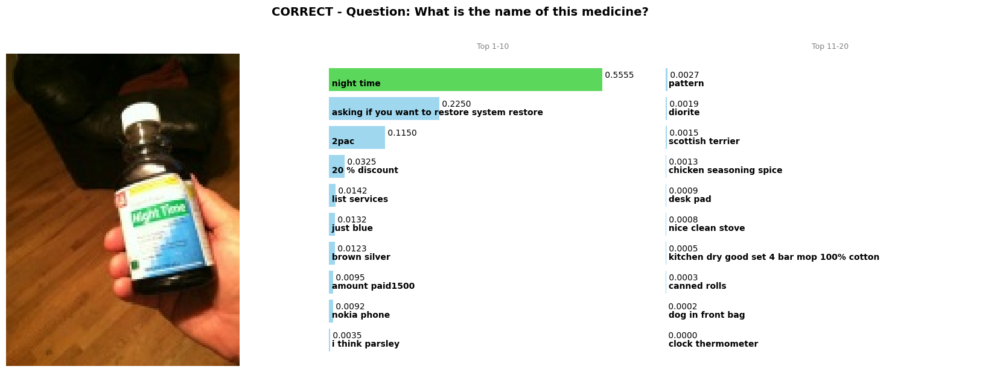

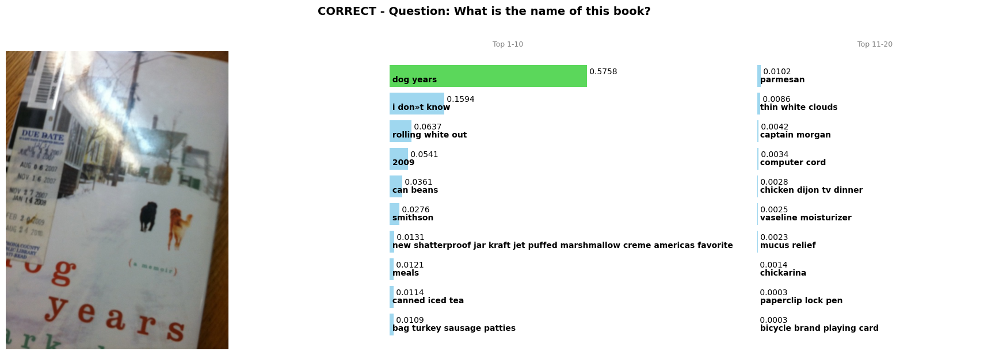

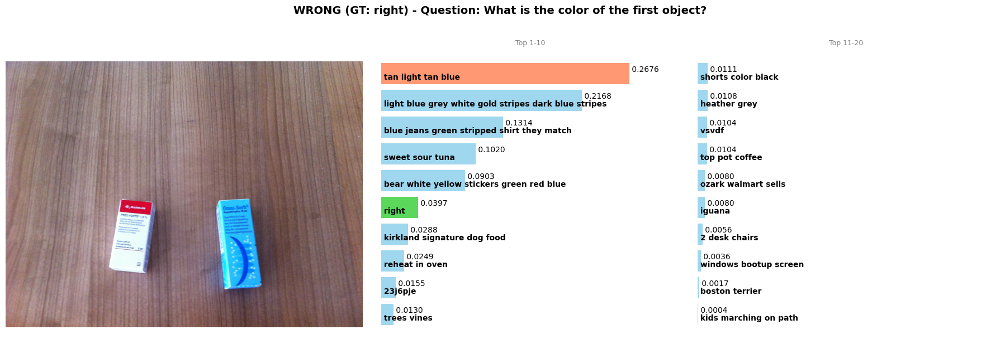

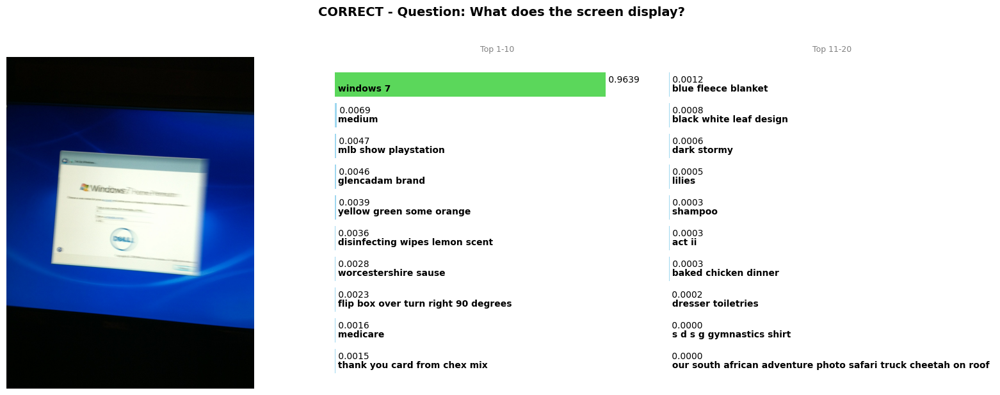

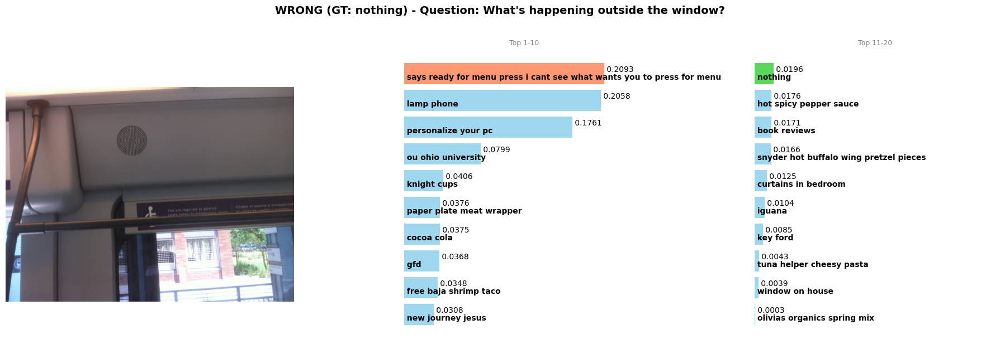

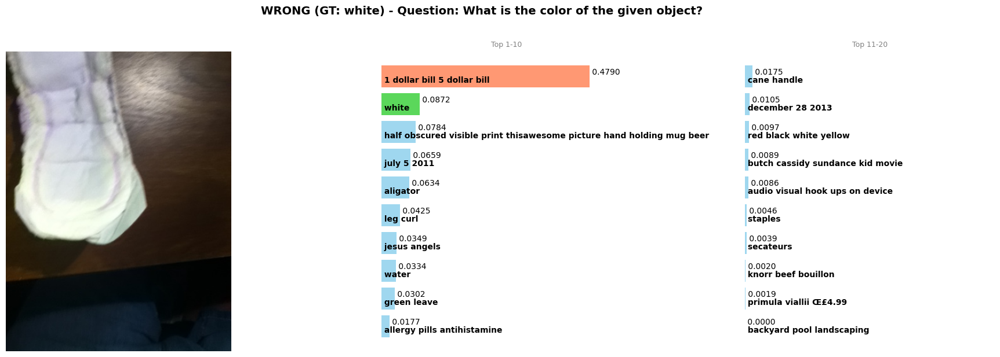

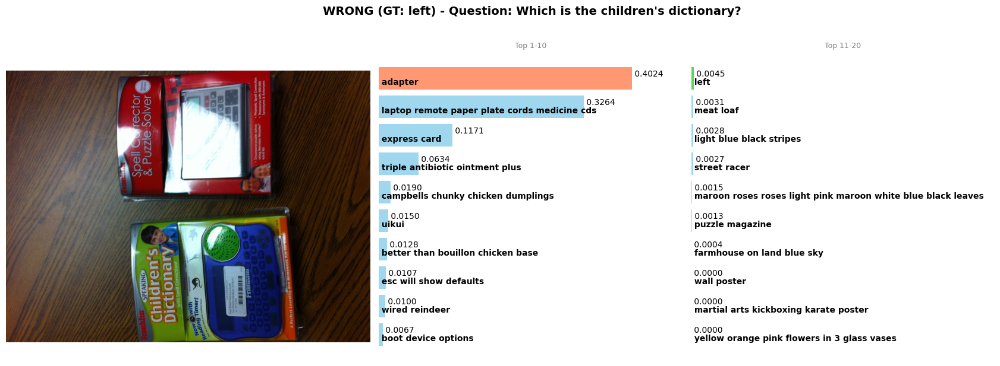

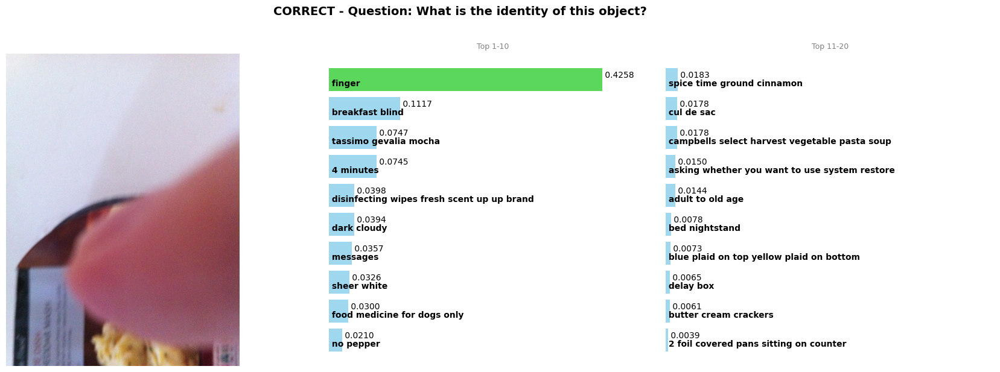

In [31]:
visualize_the_results(model, rval_loader, device, temperature=None)

### FINETUNING SUR QUESTION REFORMULÉE

In [32]:
if __name__ == "__main__":

    lr = 1e-7
    epochs = 20
    temp = 0.07

    model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
    criterion = torch.nn.CrossEntropyLoss(reduction='sum')        # pour calculer la somme des loss sur le batch (pas la moy)
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    # LR Scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=1)

    # Early stopping
    best_val_loss = float('inf')
    patience_es = 2
    counter_es = 0
    stoped_epoch = -1
    best_path = f"reform_best_clip{MAX_LENGTH}.pth"

    train_losses, val_losses = [], []
    train_accuracies, val_accuracies = [], []

    for epoch in range(epochs):

        logger.info(f'\nEPOCH {epoch+1}/{epochs}')
        logger.info(f'----- TRAINING LOOP {epoch+1}/{epochs}')
        model, train_loss, train_accuracy = train_loop(model, train_loader, epoch, temp, device, criterion, 
                                                       optimizer, scheduler=None, log=True)
        logger.info(f"### [TRAIN {epoch+1}/{epochs}] Train loss: {train_loss:.4f} | Train acc: {train_accuracy:.4f}")
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)

        logger.info(f'----- VALIDATION LOOP {epoch+1}/{epochs}')
        val_loss, val_accuracy = val_loop(model, rval_loader, epoch, temp, device, criterion, log=True)
        logger.info(f"### [TEST {epoch+1}/{epochs}] Val loss: {val_loss:.4f} | Val acc: {val_accuracy:.4f}")
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        scheduler.step(val_loss)

        # early stopping & save best
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            counter_es = 0
            torch.save(model.state_dict(), best_path)
            print(f"  -> meilleur modèle sauvegardé (val_loss={best_val_loss:.4f})")
        else:
            counter_es += 1
            if counter_es >= patience_es:
                print(f"Early stopping (no improvement for {patience_es} epochs).")
                stoped_epoch = epoch
                break

    # charger meilleur modèle
    if os.path.exists(best_path):
        model.load_state_dict(torch.load(best_path, map_location=device))
        print("Meilleur modèle chargé depuis", best_path)

    # Évaluation finale sur test set
    test_loss, test_acc = val_loop(model, rval_loader, epoch, temp, device, criterion, log=False)
    logger.info(f"[FINAL TEST] Test Loss: {test_loss:.4f}, Acc: {test_acc:.4f}")


2026-01-30 20:52:22.200 | INFO     | __main__:<module>:26 - 
EPOCH 1/20
2026-01-30 20:52:22.201 | INFO     | __main__:<module>:27 - ----- TRAINING LOOP 1/20
2026-01-30 20:52:24.182 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 0/49 | Running loss: 2.0362 | Running accuracy: 0.8750
2026-01-30 20:52:31.662 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 10/49 | Running loss: 2.3956 | Running accuracy: 0.6136
2026-01-30 20:52:38.985 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 20/49 | Running loss: 2.4093 | Running accuracy: 0.5952
2026-01-30 20:52:46.272 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 30/49 | Running loss: 2.4391 | Running accuracy: 0.5726
2026-01-30 20:52:53.537 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 40/49 | Running loss: 2.4313 | Running accuracy: 0.5610
2026-01-30 20:53:00.165 | INFO     | __main__:train_loop:56 - Epoch 1 | Batch 49/49 | Running loss: 2.4310 | Running accuracy: 0.5675
2026-01-30 20:53:00.166 | INFO     | __m

  -> meilleur modèle sauvegardé (val_loss=2.5572)


2026-01-30 20:53:05.394 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 0/49 | Running loss: 2.6644 | Running accuracy: 0.5000
2026-01-30 20:53:12.745 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 10/49 | Running loss: 2.4098 | Running accuracy: 0.6250
2026-01-30 20:53:20.124 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 20/49 | Running loss: 2.3735 | Running accuracy: 0.6012
2026-01-30 20:53:27.569 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 30/49 | Running loss: 2.3551 | Running accuracy: 0.6169
2026-01-30 20:53:34.928 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 40/49 | Running loss: 2.3439 | Running accuracy: 0.6037
2026-01-30 20:53:41.706 | INFO     | __main__:train_loop:56 - Epoch 2 | Batch 49/49 | Running loss: 2.3350 | Running accuracy: 0.6075
2026-01-30 20:53:41.707 | INFO     | __main__:<module>:30 - ### [TRAIN 2/20] Train loss: 2.3350 | Train acc: 0.6075
2026-01-30 20:53:41.707 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=2.5069)


2026-01-30 20:53:46.929 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 0/49 | Running loss: 2.3603 | Running accuracy: 0.6250
2026-01-30 20:53:54.198 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 10/49 | Running loss: 2.3319 | Running accuracy: 0.5795
2026-01-30 20:54:01.691 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 20/49 | Running loss: 2.3062 | Running accuracy: 0.5774
2026-01-30 20:54:09.113 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 30/49 | Running loss: 2.2691 | Running accuracy: 0.6008
2026-01-30 20:54:16.607 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 40/49 | Running loss: 2.2377 | Running accuracy: 0.6341
2026-01-30 20:54:23.308 | INFO     | __main__:train_loop:56 - Epoch 3 | Batch 49/49 | Running loss: 2.2387 | Running accuracy: 0.6475
2026-01-30 20:54:23.308 | INFO     | __main__:<module>:30 - ### [TRAIN 3/20] Train loss: 2.2387 | Train acc: 0.6475
2026-01-30 20:54:23.309 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=2.4536)


2026-01-30 20:54:28.515 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 0/49 | Running loss: 2.1960 | Running accuracy: 0.8750
2026-01-30 20:54:35.840 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 10/49 | Running loss: 2.1526 | Running accuracy: 0.7614
2026-01-30 20:54:43.182 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 20/49 | Running loss: 2.1930 | Running accuracy: 0.7202
2026-01-30 20:54:50.457 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 30/49 | Running loss: 2.1711 | Running accuracy: 0.7097
2026-01-30 20:54:57.741 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 40/49 | Running loss: 2.1461 | Running accuracy: 0.6951
2026-01-30 20:55:04.396 | INFO     | __main__:train_loop:56 - Epoch 4 | Batch 49/49 | Running loss: 2.1400 | Running accuracy: 0.6925
2026-01-30 20:55:04.397 | INFO     | __main__:<module>:30 - ### [TRAIN 4/20] Train loss: 2.1400 | Train acc: 0.6925
2026-01-30 20:55:04.397 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=2.3934)


2026-01-30 20:55:09.667 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 0/49 | Running loss: 2.0727 | Running accuracy: 0.7500
2026-01-30 20:55:16.921 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 10/49 | Running loss: 1.9953 | Running accuracy: 0.7386
2026-01-30 20:55:24.186 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 20/49 | Running loss: 2.0105 | Running accuracy: 0.7202
2026-01-30 20:55:31.526 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 30/49 | Running loss: 2.0516 | Running accuracy: 0.7177
2026-01-30 20:55:38.884 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 40/49 | Running loss: 2.0408 | Running accuracy: 0.7226
2026-01-30 20:55:45.558 | INFO     | __main__:train_loop:56 - Epoch 5 | Batch 49/49 | Running loss: 2.0391 | Running accuracy: 0.7125
2026-01-30 20:55:45.558 | INFO     | __main__:<module>:30 - ### [TRAIN 5/20] Train loss: 2.0391 | Train acc: 0.7125
2026-01-30 20:55:45.558 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=2.3317)


2026-01-30 20:55:50.795 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 0/49 | Running loss: 2.0783 | Running accuracy: 0.7500
2026-01-30 20:55:58.150 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 10/49 | Running loss: 2.0213 | Running accuracy: 0.6477
2026-01-30 20:56:05.648 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 20/49 | Running loss: 2.0044 | Running accuracy: 0.6667
2026-01-30 20:56:12.936 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 30/49 | Running loss: 1.9432 | Running accuracy: 0.7258
2026-01-30 20:56:20.185 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 40/49 | Running loss: 1.9318 | Running accuracy: 0.7409
2026-01-30 20:56:26.782 | INFO     | __main__:train_loop:56 - Epoch 6 | Batch 49/49 | Running loss: 1.9377 | Running accuracy: 0.7400
2026-01-30 20:56:26.783 | INFO     | __main__:<module>:30 - ### [TRAIN 6/20] Train loss: 1.9377 | Train acc: 0.7400
2026-01-30 20:56:26.783 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=2.2719)


2026-01-30 20:56:31.914 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 0/49 | Running loss: 1.7161 | Running accuracy: 0.8750
2026-01-30 20:56:39.232 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 10/49 | Running loss: 1.8901 | Running accuracy: 0.7955
2026-01-30 20:56:46.426 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 20/49 | Running loss: 1.9019 | Running accuracy: 0.7738
2026-01-30 20:56:53.691 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 30/49 | Running loss: 1.8524 | Running accuracy: 0.7742
2026-01-30 20:57:00.861 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 40/49 | Running loss: 1.8431 | Running accuracy: 0.7622
2026-01-30 20:57:07.591 | INFO     | __main__:train_loop:56 - Epoch 7 | Batch 49/49 | Running loss: 1.8346 | Running accuracy: 0.7700
2026-01-30 20:57:07.592 | INFO     | __main__:<module>:30 - ### [TRAIN 7/20] Train loss: 1.8346 | Train acc: 0.7700
2026-01-30 20:57:07.592 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=2.2099)


2026-01-30 20:57:12.732 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 0/49 | Running loss: 1.8139 | Running accuracy: 0.8750
2026-01-30 20:57:20.197 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 10/49 | Running loss: 1.9134 | Running accuracy: 0.7386
2026-01-30 20:57:27.633 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 20/49 | Running loss: 1.8506 | Running accuracy: 0.7440
2026-01-30 20:57:35.032 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 30/49 | Running loss: 1.7738 | Running accuracy: 0.7782
2026-01-30 20:57:42.403 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 40/49 | Running loss: 1.7477 | Running accuracy: 0.7866
2026-01-30 20:57:48.980 | INFO     | __main__:train_loop:56 - Epoch 8 | Batch 49/49 | Running loss: 1.7307 | Running accuracy: 0.7875
2026-01-30 20:57:48.981 | INFO     | __main__:<module>:30 - ### [TRAIN 8/20] Train loss: 1.7307 | Train acc: 0.7875
2026-01-30 20:57:48.982 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=2.1481)


2026-01-30 20:57:54.220 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 0/49 | Running loss: 1.6672 | Running accuracy: 0.7500
2026-01-30 20:58:01.609 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 10/49 | Running loss: 1.6303 | Running accuracy: 0.8523
2026-01-30 20:58:08.884 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 20/49 | Running loss: 1.6108 | Running accuracy: 0.8393
2026-01-30 20:58:16.283 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 30/49 | Running loss: 1.6214 | Running accuracy: 0.8226
2026-01-30 20:58:23.643 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 40/49 | Running loss: 1.6087 | Running accuracy: 0.8262
2026-01-30 20:58:30.405 | INFO     | __main__:train_loop:56 - Epoch 9 | Batch 49/49 | Running loss: 1.6272 | Running accuracy: 0.8100
2026-01-30 20:58:30.406 | INFO     | __main__:<module>:30 - ### [TRAIN 9/20] Train loss: 1.6272 | Train acc: 0.8100
2026-01-30 20:58:30.406 | INFO     | __main__:<module>:34 - ----- VALIDATION LOOP

  -> meilleur modèle sauvegardé (val_loss=2.0854)


2026-01-30 20:58:35.600 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 0/49 | Running loss: 1.5636 | Running accuracy: 0.7500
2026-01-30 20:58:43.154 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 10/49 | Running loss: 1.5592 | Running accuracy: 0.7614
2026-01-30 20:58:50.463 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 20/49 | Running loss: 1.5335 | Running accuracy: 0.8095
2026-01-30 20:58:57.930 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 30/49 | Running loss: 1.5008 | Running accuracy: 0.8347
2026-01-30 20:59:05.403 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 40/49 | Running loss: 1.5093 | Running accuracy: 0.8262
2026-01-30 20:59:11.987 | INFO     | __main__:train_loop:56 - Epoch 10 | Batch 49/49 | Running loss: 1.5240 | Running accuracy: 0.8150
2026-01-30 20:59:11.988 | INFO     | __main__:<module>:30 - ### [TRAIN 10/20] Train loss: 1.5240 | Train acc: 0.8150
2026-01-30 20:59:11.988 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=2.0255)


2026-01-30 20:59:17.119 | INFO     | __main__:train_loop:56 - Epoch 11 | Batch 0/49 | Running loss: 1.2917 | Running accuracy: 1.0000
2026-01-30 20:59:24.647 | INFO     | __main__:train_loop:56 - Epoch 11 | Batch 10/49 | Running loss: 1.4304 | Running accuracy: 0.8750
2026-01-30 20:59:32.004 | INFO     | __main__:train_loop:56 - Epoch 11 | Batch 20/49 | Running loss: 1.4400 | Running accuracy: 0.8690
2026-01-30 20:59:39.274 | INFO     | __main__:train_loop:56 - Epoch 11 | Batch 30/49 | Running loss: 1.4226 | Running accuracy: 0.8508
2026-01-30 20:59:46.658 | INFO     | __main__:train_loop:56 - Epoch 11 | Batch 40/49 | Running loss: 1.4422 | Running accuracy: 0.8384
2026-01-30 20:59:53.193 | INFO     | __main__:train_loop:56 - Epoch 11 | Batch 49/49 | Running loss: 1.4243 | Running accuracy: 0.8375
2026-01-30 20:59:53.194 | INFO     | __main__:<module>:30 - ### [TRAIN 11/20] Train loss: 1.4243 | Train acc: 0.8375
2026-01-30 20:59:53.194 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.9697)


2026-01-30 20:59:58.344 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 0/49 | Running loss: 1.4272 | Running accuracy: 0.6250
2026-01-30 21:00:05.837 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 10/49 | Running loss: 1.3746 | Running accuracy: 0.8409
2026-01-30 21:00:13.215 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 20/49 | Running loss: 1.3723 | Running accuracy: 0.8512
2026-01-30 21:00:20.660 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 30/49 | Running loss: 1.3205 | Running accuracy: 0.8669
2026-01-30 21:00:28.080 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 40/49 | Running loss: 1.3294 | Running accuracy: 0.8567
2026-01-30 21:00:34.779 | INFO     | __main__:train_loop:56 - Epoch 12 | Batch 49/49 | Running loss: 1.3279 | Running accuracy: 0.8550
2026-01-30 21:00:34.780 | INFO     | __main__:<module>:30 - ### [TRAIN 12/20] Train loss: 1.3279 | Train acc: 0.8550
2026-01-30 21:00:34.780 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.9176)


2026-01-30 21:00:40.121 | INFO     | __main__:train_loop:56 - Epoch 13 | Batch 0/49 | Running loss: 1.1385 | Running accuracy: 0.8750
2026-01-30 21:00:47.645 | INFO     | __main__:train_loop:56 - Epoch 13 | Batch 10/49 | Running loss: 1.3114 | Running accuracy: 0.8409
2026-01-30 21:00:55.171 | INFO     | __main__:train_loop:56 - Epoch 13 | Batch 20/49 | Running loss: 1.2504 | Running accuracy: 0.8571
2026-01-30 21:01:02.601 | INFO     | __main__:train_loop:56 - Epoch 13 | Batch 30/49 | Running loss: 1.2578 | Running accuracy: 0.8589
2026-01-30 21:01:10.114 | INFO     | __main__:train_loop:56 - Epoch 13 | Batch 40/49 | Running loss: 1.2493 | Running accuracy: 0.8598
2026-01-30 21:01:16.919 | INFO     | __main__:train_loop:56 - Epoch 13 | Batch 49/49 | Running loss: 1.2344 | Running accuracy: 0.8650
2026-01-30 21:01:16.920 | INFO     | __main__:<module>:30 - ### [TRAIN 13/20] Train loss: 1.2344 | Train acc: 0.8650
2026-01-30 21:01:16.920 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.8714)


2026-01-30 21:01:22.311 | INFO     | __main__:train_loop:56 - Epoch 14 | Batch 0/49 | Running loss: 1.5644 | Running accuracy: 0.8750
2026-01-30 21:01:29.909 | INFO     | __main__:train_loop:56 - Epoch 14 | Batch 10/49 | Running loss: 1.2863 | Running accuracy: 0.8636
2026-01-30 21:01:37.476 | INFO     | __main__:train_loop:56 - Epoch 14 | Batch 20/49 | Running loss: 1.2868 | Running accuracy: 0.8452
2026-01-30 21:01:45.033 | INFO     | __main__:train_loop:56 - Epoch 14 | Batch 30/49 | Running loss: 1.2126 | Running accuracy: 0.8589
2026-01-30 21:01:52.629 | INFO     | __main__:train_loop:56 - Epoch 14 | Batch 40/49 | Running loss: 1.1705 | Running accuracy: 0.8689
2026-01-30 21:01:59.464 | INFO     | __main__:train_loop:56 - Epoch 14 | Batch 49/49 | Running loss: 1.1487 | Running accuracy: 0.8800
2026-01-30 21:01:59.465 | INFO     | __main__:<module>:30 - ### [TRAIN 14/20] Train loss: 1.1487 | Train acc: 0.8800
2026-01-30 21:01:59.465 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.8322)


2026-01-30 21:02:05.007 | INFO     | __main__:train_loop:56 - Epoch 15 | Batch 0/49 | Running loss: 1.0057 | Running accuracy: 0.8750
2026-01-30 21:02:12.573 | INFO     | __main__:train_loop:56 - Epoch 15 | Batch 10/49 | Running loss: 1.0574 | Running accuracy: 0.8750
2026-01-30 21:02:20.186 | INFO     | __main__:train_loop:56 - Epoch 15 | Batch 20/49 | Running loss: 1.0757 | Running accuracy: 0.8512
2026-01-30 21:02:27.782 | INFO     | __main__:train_loop:56 - Epoch 15 | Batch 30/49 | Running loss: 1.0979 | Running accuracy: 0.8589
2026-01-30 21:02:35.498 | INFO     | __main__:train_loop:56 - Epoch 15 | Batch 40/49 | Running loss: 1.0938 | Running accuracy: 0.8811
2026-01-30 21:02:42.300 | INFO     | __main__:train_loop:56 - Epoch 15 | Batch 49/49 | Running loss: 1.0686 | Running accuracy: 0.8900
2026-01-30 21:02:42.301 | INFO     | __main__:<module>:30 - ### [TRAIN 15/20] Train loss: 1.0686 | Train acc: 0.8900
2026-01-30 21:02:42.301 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.7978)


2026-01-30 21:02:47.849 | INFO     | __main__:train_loop:56 - Epoch 16 | Batch 0/49 | Running loss: 1.0765 | Running accuracy: 1.0000
2026-01-30 21:02:55.374 | INFO     | __main__:train_loop:56 - Epoch 16 | Batch 10/49 | Running loss: 1.0456 | Running accuracy: 0.9091
2026-01-30 21:03:02.978 | INFO     | __main__:train_loop:56 - Epoch 16 | Batch 20/49 | Running loss: 1.0659 | Running accuracy: 0.8690
2026-01-30 21:03:10.588 | INFO     | __main__:train_loop:56 - Epoch 16 | Batch 30/49 | Running loss: 1.0257 | Running accuracy: 0.8871
2026-01-30 21:03:18.261 | INFO     | __main__:train_loop:56 - Epoch 16 | Batch 40/49 | Running loss: 1.0069 | Running accuracy: 0.9024
2026-01-30 21:03:25.037 | INFO     | __main__:train_loop:56 - Epoch 16 | Batch 49/49 | Running loss: 0.9951 | Running accuracy: 0.9000
2026-01-30 21:03:25.038 | INFO     | __main__:<module>:30 - ### [TRAIN 16/20] Train loss: 0.9951 | Train acc: 0.9000
2026-01-30 21:03:25.038 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.7689)


2026-01-30 21:03:30.642 | INFO     | __main__:train_loop:56 - Epoch 17 | Batch 0/49 | Running loss: 0.8624 | Running accuracy: 1.0000
2026-01-30 21:03:38.080 | INFO     | __main__:train_loop:56 - Epoch 17 | Batch 10/49 | Running loss: 0.9972 | Running accuracy: 0.9205
2026-01-30 21:03:45.649 | INFO     | __main__:train_loop:56 - Epoch 17 | Batch 20/49 | Running loss: 0.9383 | Running accuracy: 0.9405
2026-01-30 21:03:53.245 | INFO     | __main__:train_loop:56 - Epoch 17 | Batch 30/49 | Running loss: 0.9424 | Running accuracy: 0.9355
2026-01-30 21:04:00.878 | INFO     | __main__:train_loop:56 - Epoch 17 | Batch 40/49 | Running loss: 0.9383 | Running accuracy: 0.9177
2026-01-30 21:04:07.669 | INFO     | __main__:train_loop:56 - Epoch 17 | Batch 49/49 | Running loss: 0.9270 | Running accuracy: 0.9100
2026-01-30 21:04:07.670 | INFO     | __main__:<module>:30 - ### [TRAIN 17/20] Train loss: 0.9270 | Train acc: 0.9100
2026-01-30 21:04:07.670 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.7425)


2026-01-30 21:04:13.250 | INFO     | __main__:train_loop:56 - Epoch 18 | Batch 0/49 | Running loss: 1.0733 | Running accuracy: 1.0000
2026-01-30 21:04:20.714 | INFO     | __main__:train_loop:56 - Epoch 18 | Batch 10/49 | Running loss: 0.9472 | Running accuracy: 0.9091
2026-01-30 21:04:28.409 | INFO     | __main__:train_loop:56 - Epoch 18 | Batch 20/49 | Running loss: 0.8686 | Running accuracy: 0.9286
2026-01-30 21:04:36.166 | INFO     | __main__:train_loop:56 - Epoch 18 | Batch 30/49 | Running loss: 0.8772 | Running accuracy: 0.9234
2026-01-30 21:04:44.139 | INFO     | __main__:train_loop:56 - Epoch 18 | Batch 40/49 | Running loss: 0.8776 | Running accuracy: 0.9238
2026-01-30 21:04:50.955 | INFO     | __main__:train_loop:56 - Epoch 18 | Batch 49/49 | Running loss: 0.8632 | Running accuracy: 0.9225
2026-01-30 21:04:50.956 | INFO     | __main__:<module>:30 - ### [TRAIN 18/20] Train loss: 0.8632 | Train acc: 0.9225
2026-01-30 21:04:50.956 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.7188)


2026-01-30 21:04:56.547 | INFO     | __main__:train_loop:56 - Epoch 19 | Batch 0/49 | Running loss: 0.9282 | Running accuracy: 0.8750
2026-01-30 21:05:03.952 | INFO     | __main__:train_loop:56 - Epoch 19 | Batch 10/49 | Running loss: 0.7913 | Running accuracy: 0.9091
2026-01-30 21:05:11.531 | INFO     | __main__:train_loop:56 - Epoch 19 | Batch 20/49 | Running loss: 0.7603 | Running accuracy: 0.9405
2026-01-30 21:05:19.170 | INFO     | __main__:train_loop:56 - Epoch 19 | Batch 30/49 | Running loss: 0.7805 | Running accuracy: 0.9355
2026-01-30 21:05:26.695 | INFO     | __main__:train_loop:56 - Epoch 19 | Batch 40/49 | Running loss: 0.8067 | Running accuracy: 0.9268
2026-01-30 21:05:33.458 | INFO     | __main__:train_loop:56 - Epoch 19 | Batch 49/49 | Running loss: 0.8049 | Running accuracy: 0.9275
2026-01-30 21:05:33.459 | INFO     | __main__:<module>:30 - ### [TRAIN 19/20] Train loss: 0.8049 | Train acc: 0.9275
2026-01-30 21:05:33.459 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.6996)


2026-01-30 21:05:38.967 | INFO     | __main__:train_loop:56 - Epoch 20 | Batch 0/49 | Running loss: 0.8600 | Running accuracy: 1.0000
2026-01-30 21:05:46.329 | INFO     | __main__:train_loop:56 - Epoch 20 | Batch 10/49 | Running loss: 0.7196 | Running accuracy: 0.9886
2026-01-30 21:05:53.847 | INFO     | __main__:train_loop:56 - Epoch 20 | Batch 20/49 | Running loss: 0.7540 | Running accuracy: 0.9643
2026-01-30 21:06:01.400 | INFO     | __main__:train_loop:56 - Epoch 20 | Batch 30/49 | Running loss: 0.7329 | Running accuracy: 0.9556
2026-01-30 21:06:08.885 | INFO     | __main__:train_loop:56 - Epoch 20 | Batch 40/49 | Running loss: 0.7605 | Running accuracy: 0.9360
2026-01-30 21:06:15.675 | INFO     | __main__:train_loop:56 - Epoch 20 | Batch 49/49 | Running loss: 0.7510 | Running accuracy: 0.9350
2026-01-30 21:06:15.676 | INFO     | __main__:<module>:30 - ### [TRAIN 20/20] Train loss: 0.7510 | Train acc: 0.9350
2026-01-30 21:06:15.676 | INFO     | __main__:<module>:34 - ----- VALIDATI

  -> meilleur modèle sauvegardé (val_loss=1.6797)
Meilleur modèle chargé depuis reform_best_clip48.pth


2026-01-30 21:06:21.067 | INFO     | __main__:val_loop:54 - Epoch 20 | Batch 0/12 | Running loss: 1.3367 | Running accuracy: 0.8750
2026-01-30 21:06:21.964 | INFO     | __main__:val_loop:54 - Epoch 20 | Batch 3/12 | Running loss: 1.4226 | Running accuracy: 0.8125
2026-01-30 21:06:22.905 | INFO     | __main__:val_loop:54 - Epoch 20 | Batch 6/12 | Running loss: 1.5930 | Running accuracy: 0.6607
2026-01-30 21:06:23.800 | INFO     | __main__:val_loop:54 - Epoch 20 | Batch 9/12 | Running loss: 1.6235 | Running accuracy: 0.6500
2026-01-30 21:06:24.611 | INFO     | __main__:val_loop:54 - Epoch 20 | Batch 12/12 | Running loss: 1.6797 | Running accuracy: 0.6100
2026-01-30 21:06:24.611 | INFO     | __main__:<module>:62 - [FINAL TEST] Test Loss: 1.6797, Acc: 0.6100


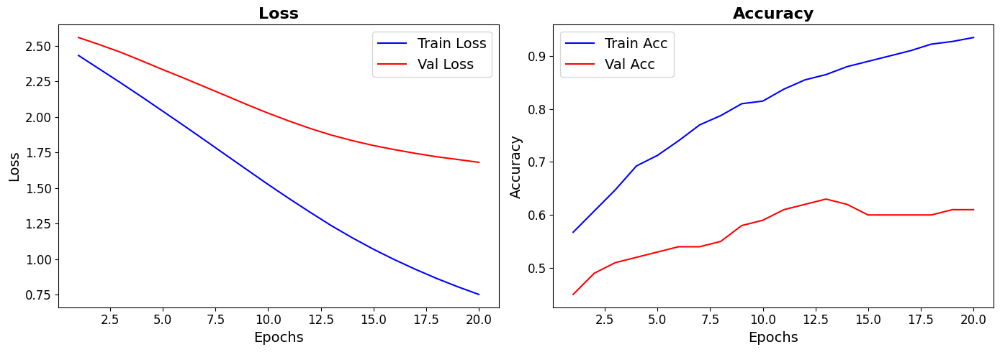

In [ ]:
import matplotlib.pyplot as plt
# Création d'une figure avec 3 sous-graphiques côte à côte
_, axes = plt.subplots(1, 2, figsize=(14, 5))

epochs_range = range(1, len(train_losses) + 1)

# --- LOSS ---
axes[0].plot(epochs_range, train_losses, label='Train Loss', color='blue')
axes[0].plot(epochs_range, val_losses, label='Val Loss', color='red')
axes[0].set_title("Loss", fontsize=16, fontweight='bold')
axes[0].set_xlabel("Epochs", fontsize=14)
axes[0].set_ylabel("Loss", fontsize=14)
#axes[0].grid(True)
axes[0].tick_params(axis='both', labelsize=12)
axes[0].legend(fontsize=14)

# --- ACCURACY ---
axes[1].plot(epochs_range, train_accuracies, label='Train Acc', color='blue')
axes[1].plot(epochs_range, val_accuracies, label='Val Acc', color='red')
axes[1].set_title("Accuracy", fontsize=16, fontweight='bold')
axes[1].set_xlabel("Epochs", fontsize=14)
axes[1].set_ylabel("Accuracy", fontsize=14)
#axes[1].grid(True)
axes[1].tick_params(axis='both', labelsize=12)
axes[1].legend(fontsize=14)

if stoped_epoch > 0: # verify stoped_epoch != -1 default initialisation => early stopping occured
    stoped_epoch = stoped_epoch - patience_es + 1
    axes[0].axvline(x=stoped_epoch, color='green', linestyle='--')
    axes[1].axvline(x=stoped_epoch, color='green', linestyle='--', label='early stopping')

plt.tight_layout()
plt.show()
plt.close()

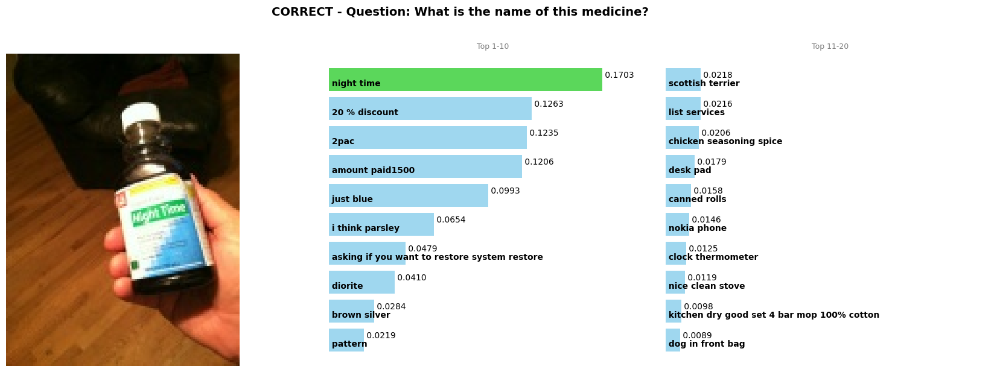

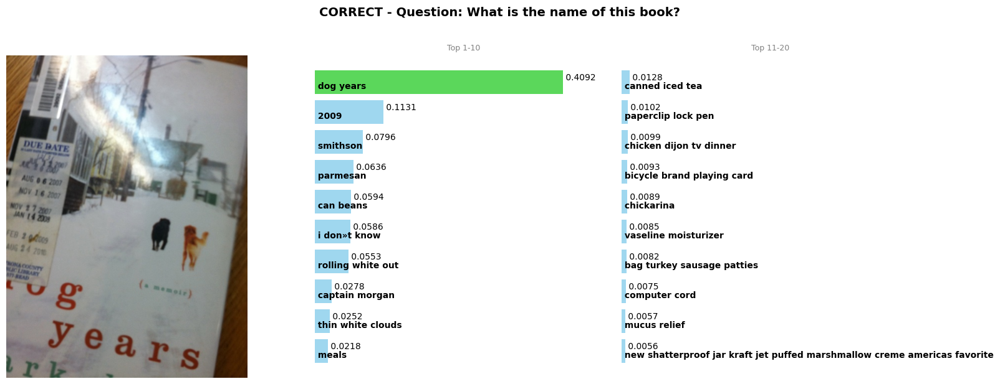

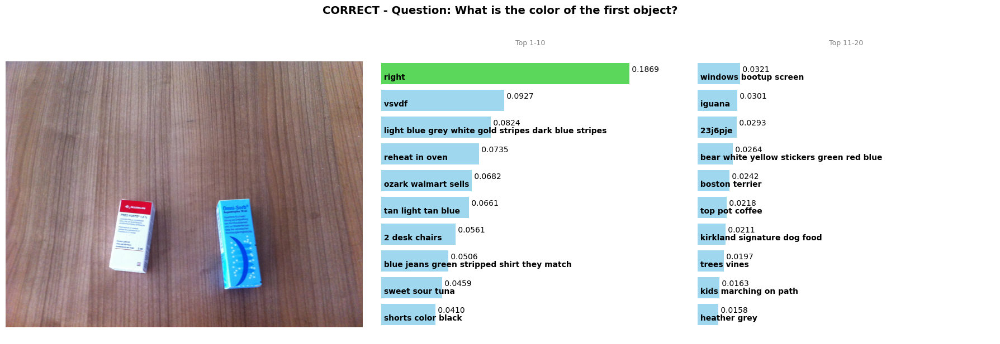

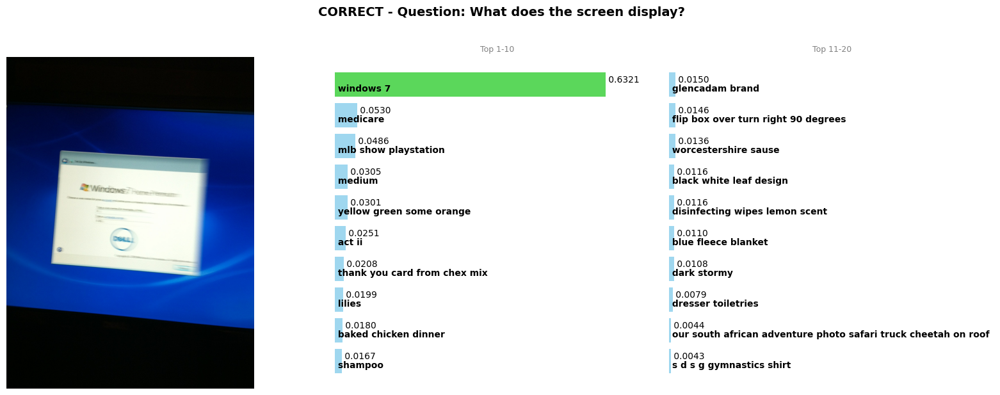

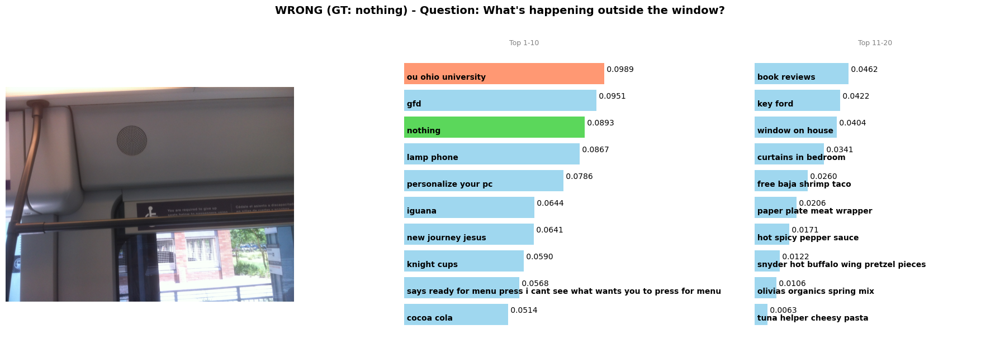

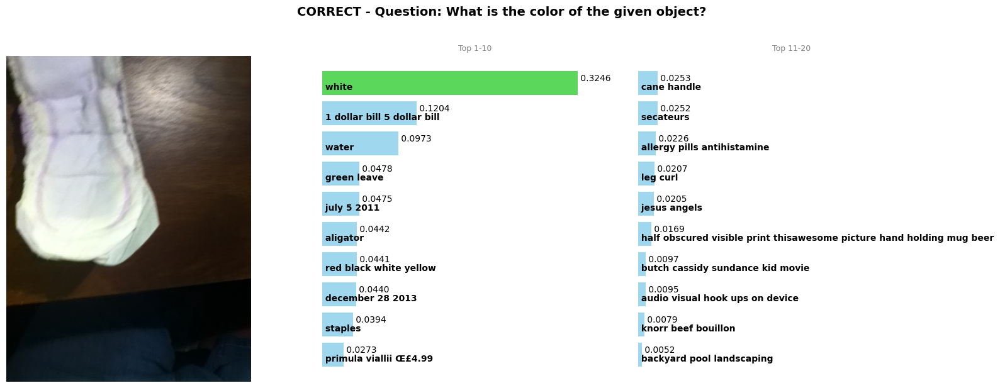

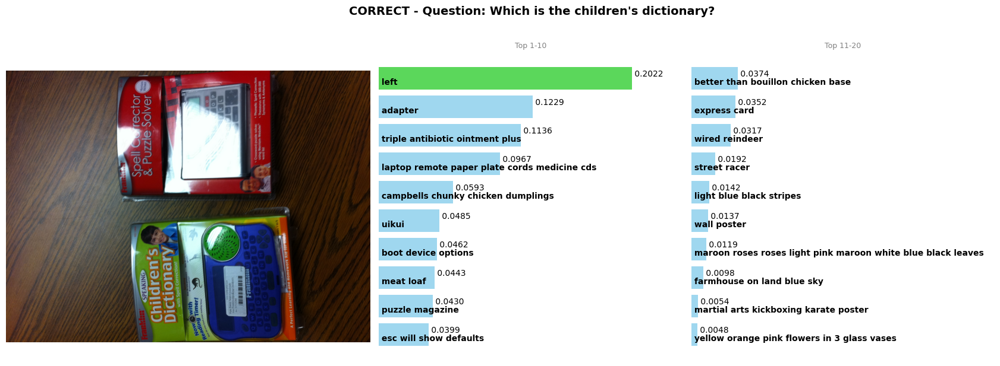

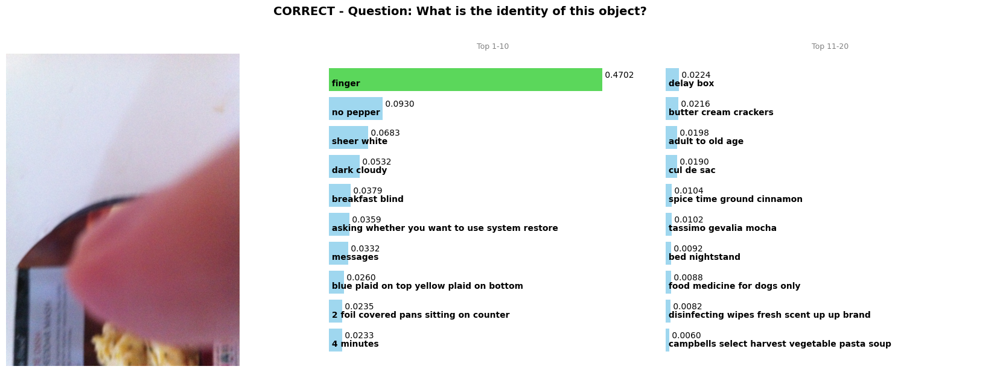

In [35]:
visualize_the_results(model, rval_loader, device, temperature=temp)

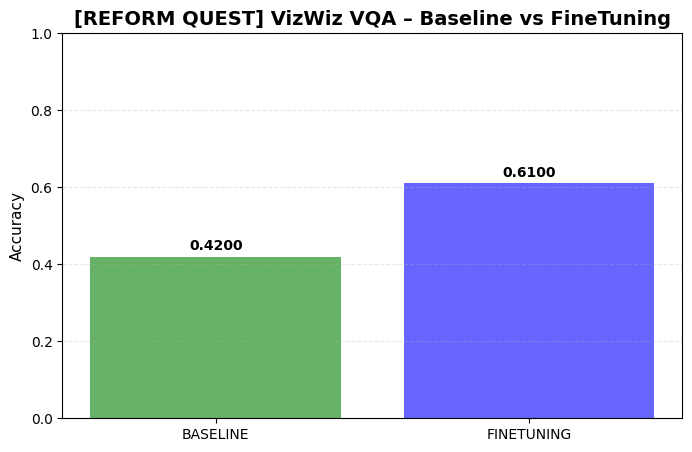

In [36]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
bars = plt.bar([label.upper() for label in ['baseline', 'finetuning']], [base_acc, test_acc],
               color=['g', 'b', 'r'], alpha=0.6)

plt.ylabel("Accuracy", fontsize=11)
plt.ylim(0, 1)
plt.xticks(fontsize=10)

plt.title("[REFORM QUEST] VizWiz VQA – Baseline vs FineTuning", fontweight='bold', fontsize=14)
plt.grid(axis="y", linestyle="--", alpha=0.3)

for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.01, f"{height:.4f}",
        ha="center", va="bottom", fontsize=10, fontweight="bold")

plt.show()

### ANALYSE DES PERFORMANCES

* **Zéro-shot (Sans fine-tuning) :** En utilisant CLIP tel quel avec les questions reformulées, on obtient une accuracy de **0,42**.
* **Fine-tuning (Questions reformulées) :** Le réentraînement sur le split *train* permet d'améliorer l'accuracy de **19 points de pourcentage** (soit 0,61).
* **Comparaison :** Malgré cette progression, les performances restent inférieures à celles obtenues via un fine-tuning sur les questions originales, qui atteint une accuracy de **0,67**.

## Comparaisons

In [37]:
base_accs = []

# --- MODEL
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")

# --- EVAL INITIAL QUEST
acc = eval_loop(model, ival_loader, device, temperature=None, log=True)
logger.info(f'[BASELINE IVAL] Accuracy: {acc:.4f}')
base_accs.append(acc)

# --- EVAL REFORM QUEST
acc = eval_loop(model, rval_loader, device, temperature=None, log=True)
logger.info(f'[BASELINE RVAL] Accuracy: {acc:.4f}')
base_accs.append(acc)

print(f'base_accs={base_accs}')

2026-01-30 21:06:29.072 | INFO     | __main__:eval_loop:53 - Batch 0/12 	 running_accuracy = 0.5000
2026-01-30 21:06:29.970 | INFO     | __main__:eval_loop:53 - Batch 3/12 	 running_accuracy = 0.5312
2026-01-30 21:06:30.888 | INFO     | __main__:eval_loop:53 - Batch 6/12 	 running_accuracy = 0.4821
2026-01-30 21:06:31.732 | INFO     | __main__:eval_loop:53 - Batch 9/12 	 running_accuracy = 0.4750
2026-01-30 21:06:32.467 | INFO     | __main__:eval_loop:53 - Batch 12/12 	 running_accuracy = 0.4500
2026-01-30 21:06:32.468 | INFO     | __main__:<module>:8 - [BASELINE IVAL] Accuracy: 0.4500
2026-01-30 21:06:32.806 | INFO     | __main__:eval_loop:53 - Batch 0/12 	 running_accuracy = 0.5000
2026-01-30 21:06:33.740 | INFO     | __main__:eval_loop:53 - Batch 3/12 	 running_accuracy = 0.4688
2026-01-30 21:06:34.647 | INFO     | __main__:eval_loop:53 - Batch 6/12 	 running_accuracy = 0.3929
2026-01-30 21:06:35.495 | INFO     | __main__:eval_loop:53 - Batch 9/12 	 running_accuracy = 0.4375
2026-01

base_accs=[0.45, 0.42]


In [38]:
clip_iquest_accs = []

# --- MODEL
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
best_path = f"best_clip{MAX_LENGTH}.pth"
if os.path.exists(best_path):
    model.load_state_dict(torch.load(best_path, map_location=device))
    print("Modèle chargé depuis", best_path)

# --- EVAL INITIAL QUEST
acc = eval_loop(model, ival_loader, device, temperature=temp, log=True)
logger.info(f'[BASELINE IVAL] Accuracy: {acc:.4f}')
clip_iquest_accs.append(acc)

# --- EVAL REFORM QUEST
acc = eval_loop(model, rval_loader, device, temperature=temp, log=True)
logger.info(f'[BASELINE RVAL] Accuracy: {acc:.4f}')
clip_iquest_accs.append(acc)

print(f'clip_iquest_accs={clip_iquest_accs}')

Modèle chargé depuis best_clip48.pth


2026-01-30 21:06:37.580 | INFO     | __main__:eval_loop:53 - Batch 0/12 	 running_accuracy = 0.5000
2026-01-30 21:06:38.476 | INFO     | __main__:eval_loop:53 - Batch 3/12 	 running_accuracy = 0.6875
2026-01-30 21:06:39.432 | INFO     | __main__:eval_loop:53 - Batch 6/12 	 running_accuracy = 0.6964
2026-01-30 21:06:40.344 | INFO     | __main__:eval_loop:53 - Batch 9/12 	 running_accuracy = 0.6375
2026-01-30 21:06:41.172 | INFO     | __main__:eval_loop:53 - Batch 12/12 	 running_accuracy = 0.6400
2026-01-30 21:06:41.172 | INFO     | __main__:<module>:12 - [BASELINE IVAL] Accuracy: 0.6400
2026-01-30 21:06:41.539 | INFO     | __main__:eval_loop:53 - Batch 0/12 	 running_accuracy = 0.7500
2026-01-30 21:06:42.538 | INFO     | __main__:eval_loop:53 - Batch 3/12 	 running_accuracy = 0.6250
2026-01-30 21:06:43.547 | INFO     | __main__:eval_loop:53 - Batch 6/12 	 running_accuracy = 0.6071
2026-01-30 21:06:44.474 | INFO     | __main__:eval_loop:53 - Batch 9/12 	 running_accuracy = 0.5750
2026-0

clip_iquest_accs=[0.64, 0.55]


In [41]:
clip_rquest_accs = []

# --- MODEL
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
best_path = f"reform_best_clip{MAX_LENGTH}.pth"
if os.path.exists(best_path):
    model.load_state_dict(torch.load(best_path, map_location=device))
    print("Modèle chargé depuis", best_path)

# --- EVAL INITIAL QUEST
acc = eval_loop(model, ival_loader, device, temperature=temp, log=True)
logger.info(f'[BASELINE IVAL] Accuracy: {acc:.4f}')
clip_rquest_accs.append(acc)

# --- EVAL REFORM QUEST
acc = eval_loop(model, rval_loader, device, temperature=temp, log=True)
logger.info(f'[BASELINE RVAL] Accuracy: {acc:.4f}')
clip_rquest_accs.append(acc)

print(f'clip_rquest_accs={clip_rquest_accs}')

Modèle chargé depuis reform_best_clip48.pth


2026-01-30 21:08:27.399 | INFO     | __main__:eval_loop:53 - Batch 0/12 	 running_accuracy = 0.5000
2026-01-30 21:08:28.325 | INFO     | __main__:eval_loop:53 - Batch 3/12 	 running_accuracy = 0.5938
2026-01-30 21:08:29.261 | INFO     | __main__:eval_loop:53 - Batch 6/12 	 running_accuracy = 0.6071
2026-01-30 21:08:30.129 | INFO     | __main__:eval_loop:53 - Batch 9/12 	 running_accuracy = 0.6125
2026-01-30 21:08:30.896 | INFO     | __main__:eval_loop:53 - Batch 12/12 	 running_accuracy = 0.6300
2026-01-30 21:08:30.897 | INFO     | __main__:<module>:12 - [BASELINE IVAL] Accuracy: 0.6300
2026-01-30 21:08:31.215 | INFO     | __main__:eval_loop:53 - Batch 0/12 	 running_accuracy = 0.8750
2026-01-30 21:08:32.106 | INFO     | __main__:eval_loop:53 - Batch 3/12 	 running_accuracy = 0.8125
2026-01-30 21:08:33.024 | INFO     | __main__:eval_loop:53 - Batch 6/12 	 running_accuracy = 0.6607
2026-01-30 21:08:33.876 | INFO     | __main__:eval_loop:53 - Batch 9/12 	 running_accuracy = 0.6500
2026-0

clip_rquest_accs=[0.63, 0.61]


In [42]:
print('base_accs=',base_accs)
print('clip_iquest_accs=',clip_iquest_accs)
print('clip_rquest_accs=',clip_rquest_accs)

base_accs= [0.45, 0.42]
clip_iquest_accs= [0.64, 0.55]
clip_rquest_accs= [0.63, 0.61]


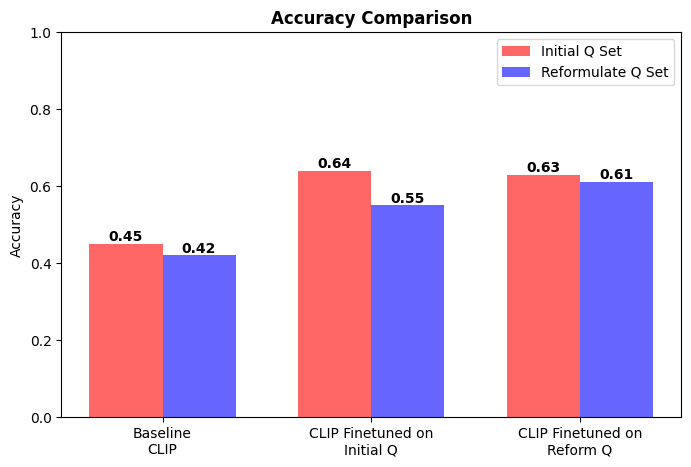

In [43]:
import matplotlib.pyplot as plt
import numpy as np

# Data
labels = ['Baseline\nCLIP', 'CLIP Finetuned on\nInitial Q', 'CLIP Finetuned on\nReform Q']
accs_list = [base_accs, clip_iquest_accs, clip_rquest_accs]

initial_question = [res[0] for res in accs_list]
reformulate_question = [res[1] for res in accs_list]

x = np.arange(len(labels))
width = 0.35

plt.figure(figsize=(8,5))

bars1 = plt.bar(x - width/2, initial_question, width, label='Initial Q Set', color='r', alpha=0.6)
bars2 = plt.bar(x + width/2, reformulate_question, width, label='Reformulate Q Set', color='b', alpha=0.6)

def add_bar_labels(bars):
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.2f}',
                 ha='center', va='bottom', fontweight='bold')

add_bar_labels(bars1)
add_bar_labels(bars2)

plt.xticks(x, labels)
plt.ylim(0.,1.)
plt.ylabel('Accuracy')
plt.title('Accuracy Comparison', fontweight='bold')
plt.legend()

plt.show()


### Comparaison des approches de Fine-tuning

L'analyse des résultats met en évidence trois constats majeurs :

1. **Baseline CLIP (Zéro-shot) :** Sans fine-tuning, le modèle performe légèrement mieux sur les **questions d'origine** (accuracy = **0,45**) que sur les versions reformulées (accuracy = **0,42**).

2. **Fine-tuning sur questions initiales :** Cette approche montre des performances meilleurs sur le dataset d'origine (accuracy = **0,64**) et une dégradation des performances si on reformule les questions pour prédire la réponse (accuracy = **0,55**).

3. **Fine-tuning sur questions reformulées :** Cette stratégie s'avère contre-productive. Le modèle obtient de moins bons résultats sur son propre set de validation (questions reformulées) que sur les questions initiales. 

---

> **Conclusion :** L'approche par reformulation est définitivement invalidée, du moins avec le LLM (Mistral-7B) utilisés. Elle est au mieux **inutile** (stagnation de la précision), au pire **rédhibitoire** (dégradation des performances globales). 
> 
> **La meilleure configuration demeure le fine-tuning sur les questions initiales.**

# 5. Perspectives d’amélioration

- **Augmenter la taille du jeu de données :** Actuellement, nous n’utilisons que 400 exemples sur les 15 000 disponibles en raison de contraintes de calcul. Malgré la petite taille du jeu de données, nous avons constaté une amélioration significative de la précision, passant de 0,40 à 0,67 sur 100 images du split de validation. Ce résultat encourageant suggère qu’un entraînement plus complet pourrait conduire à des performances encore meilleures.

- **Utiliser un autre LLM pour reformuler les questions** :  Cette méthode n’est pas pertinente ici avec Mistral-7B, car les questions reformulées sont très variables.  Parfois, la reformulation est pertinente et pose mieux la question, mais d’autres fois, elle diffère complètement de la question initiale, voire entraîne des hallucinations où le modèle ajoute du code Python.

- **Générer des candidats à partir de la question pour un cas d’utilisation réel :** Dans un scénario réel, les utilisateurs prendraient des photos et poseraient des questions à l’oral. Le modèle générerait alors des candidats et les classerait en utilisant le travail accompli ici.

- **Tester d’autres modèles multimodaux :** Bien que CLIP ait été choisi pour sa disponibilité en open source et ses performances, d’autres modèles multimodaux pourraient être explorés pour des résultats potentiellement meilleurs.